# Title: Classification of Mobile Price

##Problem Statement: 

The client plans to start a mobile phone company. He wants to give tough fights to big companies such as Apple, Samsung, Huawei and others. However, the cient now faces a problem to set the price of the mobile phone. 

In order to set a reasonable price, he needs to predict the price of the mobile phone based on the features of the mobile phone. Hence, the client has collected the sales data of mobile phones of different companies. He cannot simply set a price for the mobile phone because the price is the main consideration for many people when buying a mobile phone. He needs to figure out the relationship between features of a mobile phone(eg:- battery power, RAM etc) and its selling price. 

To solve this problem, he decided to approach us to help him using Machine Learning techniques. In this problem we are predicting the price range indicating how high the price should be relative to the competition instead of the actual prices.



---



The dataset is obtained from Kaggle - titled 'Mobile Price Classification', uploaded by Abhishek Sharma.<br>
The dataset is widelly used, with over 1500 code submitted, though not all are complete models.

In one model, Gulsah Demiryurek used SVM to predict the price range, employing cross validation and GridSearchCV to refine her model. The final model performed with 96.44% accuracy on training data and 93.75% on test data.

Feri Haldi Tanjung wrote a multiclass classification using 5 models with a resulting accuracy score of 93%. He improved upon his initial code by creating a feature importance graph for the models, which showed RAM, Power Battery, Height and Width as the most important features, then updating these features in the models. He concluded that Extra Tree Classifier with feature selection possessed the best condition for classifying (No overfit or underfit).

Vikramaditya SIngh Bhati concluded in his exploration that KNN and Linear Regression (LR) performed the best among his models. KNN returned a score of 93% while LR had a score of above 90%.

###Imports

In [ ]:
#imports
from __future__ import print_function
from scipy.cluster import hierarchy
from matplotlib import colors
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns
%matplotlib inline

from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit, GridSearchCV, cross_val_score
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, label_binarize, OneHotEncoder
from sklearn import metrics
from sklearn.metrics import silhouette_score, confusion_matrix, classification_report, accuracy_score, roc_auc_score, precision_recall_fscore_support as prfscore, log_loss
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, Birch
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.ensemble import VotingClassifier, GradientBoostingClassifier, RandomForestClassifier 
from sklearn.naive_bayes import GaussianNB, BernoulliNB, MultinomialNB, ComplementNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.feature_selection import SelectKBest, f_classif

import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from keras.optimizers import RMSprop

import warnings
warnings.filterwarnings("ignore")

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving train.csv to train.csv


In [ ]:
import os
import pandas as pd

filepath = os.sep.join(['train.csv'])
data = pd.read_csv(filepath, sep=',')

###Data Pre-processing and Visualisations

In [ ]:
print(data.shape)

(2000, 21)


In [ ]:
data.head(5)

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

The dataset has 21 features and 2000 entries. The meanings of the features are given below.

**battery_power**: Total energy a battery can store in one time measured in mAh

**blue**: Has bluetooth or not

**clock_speed**: speed at which microprocessor executes instructions

**dual_sim**: Has dual sim support or not

**fc**: Front Camera mega pixels

**four_g**: Has 4G or not

**int_memory**: Internal Memory in Gigabytes

**m_dep**: Mobile Depth in cm

**mobile_wt**: Weight of mobile phone

**n_cores**: Number of cores of processor

**pc**: Primary Camera mega pixels

**px_height**: Pixel Resolution Height

**px_width**: Pixel Resolution Width

**ram**: Random Access Memory in Mega Bytes

**sc_h**: Screen Height of mobile in cm

**sc_w**: Screen Width of mobile in cm

**talk_time**: longest time that a single battery charge will last when you are

**three_g**: Has 3G or not

**touch_screen**: Has touch screen or not

**wifi**: Has wifi or not

**price_range**: This is the target variable with value of 0 (cheap), 1 (standard), 2 (expensice) and 3 (very expensive).

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
battery_power,2000.0,1238.51850,439.418206,501.0,851.75,1226.0,1615.25,1998.0
blue,2000.0,0.49500,0.500100,0.0,0.00,0.0,1.00,1.0
clock_speed,2000.0,1.52225,0.816004,0.5,0.70,1.5,2.20,3.0
dual_sim,2000.0,0.50950,0.500035,0.0,0.00,1.0,1.00,1.0
fc,2000.0,4.30950,4.341444,0.0,1.00,3.0,7.00,19.0
four_g,2000.0,0.52150,0.499662,0.0,0.00,1.0,1.00,1.0
int_memory,2000.0,32.04650,18.145715,2.0,16.00,32.0,48.00,64.0
m_dep,2000.0,0.50175,0.288416,0.1,0.20,0.5,0.80,1.0
mobile_wt,2000.0,140.24900,35.399655,80.0,109.00,141.0,170.00,200.0
n_cores,2000.0,4.52050,2.287837,1.0,3.00,4.0,7.00,8.0


In [ ]:
!pip install pandas-profiling==2.7.1

In [ ]:
import pandas_profiling
from pandas_profiling import ProfileReport
ProfileReport(data)

Summarize dataset:   0%|          | 0/33 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Using pandas_profiling's ProfileReport, we can obtain a quick exploratory data analysis of our mobile price data. 

From the variables, one thing that stands out is the high correlation between RAM and the price range This is further illustrated in the correlation plots, with RAM showing almost a 0.8 correlation score with price range.

In addition, battery power and phone screen size (px_height and px_width) may slightly affect the pricing as well.

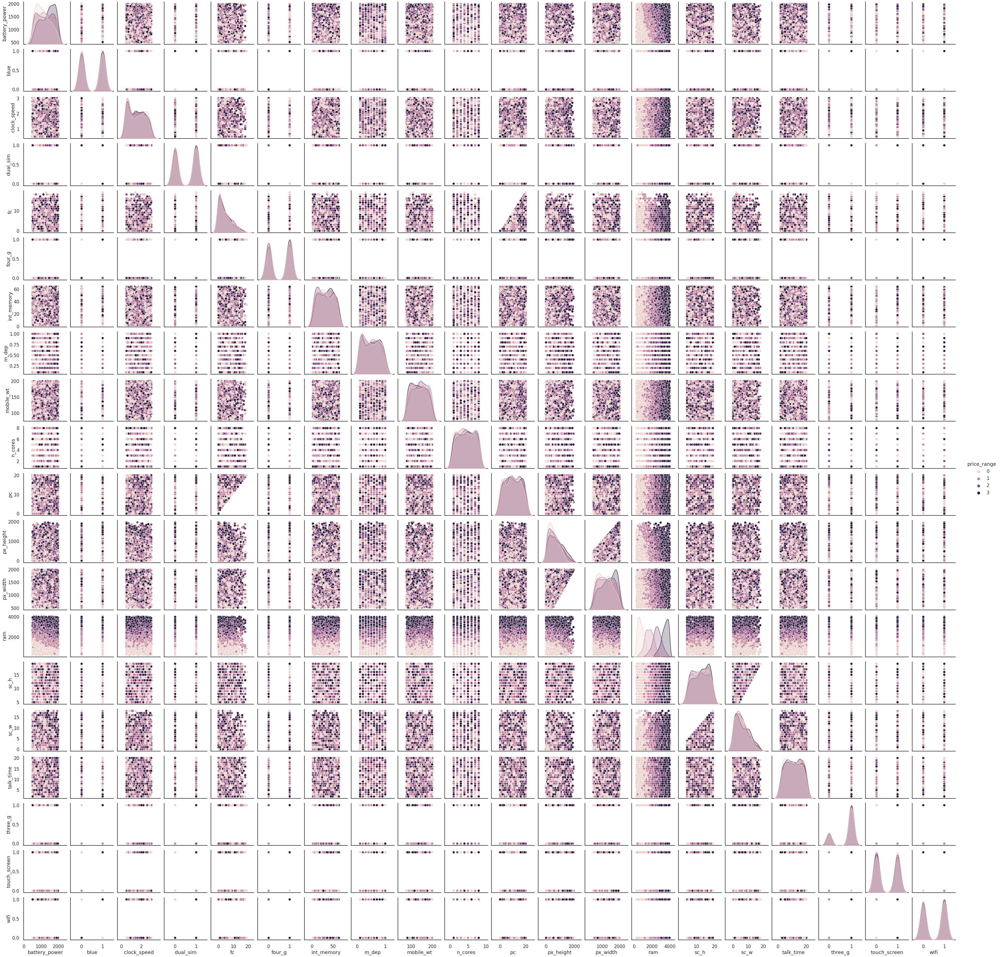

In [ ]:
#Pairplot
sns.pairplot(data,hue='price_range')

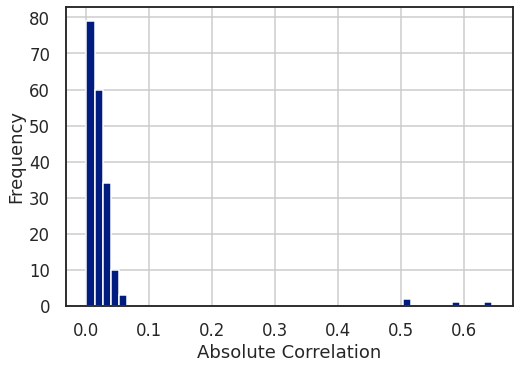

In [ ]:
# Calculate the correlation values
feature_cols = data.columns[:-1]
corr_values = data[feature_cols].corr()

# Simplify by emptying all the data below the diagonal
tril_index = np.tril_indices_from(corr_values)

# Make the unused values NaNs
for coord in zip(*tril_index):
    corr_values.iloc[coord[0], coord[1]] = np.NaN
    
# Stack the data and convert to a data frame
corr_values = (corr_values.stack().to_frame().reset_index().rename(columns={'level_0':'feature1','level_1':'feature2',0:'correlation'}))

# Get the absolute values for sorting
corr_values['abs_correlation'] = corr_values.correlation.abs()

sns.set_context('talk')
sns.set_style('white')
sns.set_palette('dark')

ax = corr_values.abs_correlation.hist(bins=50)

ax.set(xlabel='Absolute Correlation', ylabel='Frequency');

Numeric values for correlations with price range

In [ ]:
y = data['price_range']
fields = list(data.columns[:-1])  # everything except "price_range"
correlations = data[fields].corrwith(y)
correlations.sort_values(inplace=True)
correlations

touch_screen    -0.030411
mobile_wt       -0.030302
clock_speed     -0.006606
m_dep            0.000853
n_cores          0.004399
four_g           0.014772
dual_sim         0.017444
wifi             0.018785
blue             0.020573
talk_time        0.021859
fc               0.021998
sc_h             0.022986
three_g          0.023611
pc               0.033599
sc_w             0.038711
int_memory       0.044435
px_height        0.148858
px_width         0.165818
battery_power    0.200723
ram              0.917046
dtype: float64

From the graph above, we can see that most of the features have below 0.1 absolute correlation score with the price range. A small precentage of features have more than 0.5 correlation with the price range.

However, some of the features are in the form of boolean values ('0' and '1') such as 'dual_sim', 'four_g', 'touch_screen' and so on, which may be contributing to the low correlation scores.

We can see that the 4 features which are 'ram', 'battery power', 'pixel width' and 'pixel height' have higher correlation to 'price range' compared to other features.

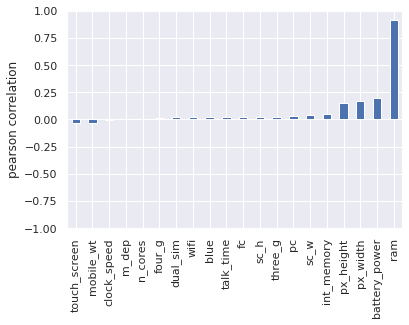

In [ ]:
ax = correlations.plot(kind='bar')
ax.set(ylim=[-1, 1], ylabel='pearson correlation');

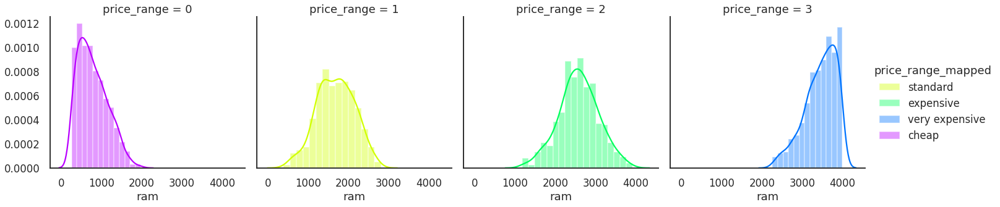

In [ ]:
price_mapping = {0: "cheap",
    1: "standard",
    2: "expensive",
    3: "very expensive"}

data['price_range_mapped'] = data['price_range'].map(price_mapping)

price_range_Vs_ram = sns.FacetGrid(data, col="price_range", hue="price_range_mapped", palette="hsv",height=5
                   )
price_range_Vs_ram.map(sns.distplot, "ram").add_legend();

data.drop(['price_range_mapped'], axis='columns', inplace=True)

The classification for mobile price can be split into four categories: 
 - 0 = Cheap 
 - 1 = Standard 
 - 2 = Expensive 
 - 3 = Very Expensive

Comparing the RAM to price ranges (as RAM has a high correlation to the price range), we observe that, generally, for each price range:

 * Cheap: RAM ranges between 0 to 2000 MB

 * Standard: RAM ranges between 0 to 3000 MB

 * Expensive: RAM ranges between 1000 to 4000 MB

 * Very Expensive: RAM ranges between 2000 to 4000 MB



##Methodology

In order to be able to provide consistent and accurate classification of the mobile price range, we shall explore various Machine Learning models and evaluate their performances against each other.



###Models

**Naive Bayes**

We use Gaussian, Bernoulli, Multinomial and Complement Naive Bayes algorithms to find out the most suitable as well as the highest accuracy model for this dataset. We use Gaussian Naive Bayes at first, then, we use 4 of the models to make comparisons among them. Then, we find the confusion matrix, predictions, accuracy score and log loss of all the models as well as the bar plot.

**KNN**

The k-nearest neighbors (KNN) algorithm is a simple, easy-to-implement non-parametric, supervised machine learning algorithm that can be used to solve classification problems. The algorithm operates on the basis that similar objects exist in close proximity to each other. Based on this assumption, KNN utilises mathematical concepts of distance, proximity or closeness to quantify the ‘proximity’ of the objects. The ‘k’ in KNN refers to the number of closest objects to any particular data point; a new data point often is classified as the same category as the majority among its ‘k’ nearest neighbours. Popular mathematical algorithms or distance metrics used to compute these are the Euclidean Distance, Manhattan Distance, Minkowski Distance, Cosine Distance, Jaccard Distance. We will use the standard KNN classifier, followed by an observation of implementing encoding and scaling techniques to the data and comparing their outcomes. A function to find a suitable k value that provides a relatively high accuracy is used to aid in our modeling efficacy.

**Support Vector Machine (SVM)**

SVM is a supervised learning algorithm that can handle classification problems well. By using the concept of support vectors, hyperplane and margin, this algorithm can classify the data into a few classes. In this work, we use the svm packages from scikit-learn to carry out the classification. We will first train a LinearSVC model and observe the accuracy. Then by using GridSearchCV, we will find out the best hyperparameters of the SVC model. After that, we will figure out the best number of features to train the SVM model without losing accuracy.  The confusion matrix, predictions and accuracy score will be printed out for each model trained.

**Logistic Regression**

Logistic regression include 6 solvers which are liblinear (L1 regularized logistic regression), L2 regularized logistic regression, newton-cg(a newton-method), lbgfs (Limited-memory Broyden_fletcher-Goldfarb-Shanno), sag (Stochastic Average Gradient descent) and saga (Extension of sag that also allows for L1 regularization). At the beginning, we calculate the probability of accuracy of each solver. Then, we run the metrics of the solver and also plot the confusion matrix. Since the newton-cg and liblinear have the highest accuracy among all, we then fit them into a voting classifier, this makes the result have higher accuracy than the newton-cg solver itself.

**Neural Network (NN)**

Neural Network is a set of algorithms that mimics how the human brain works. It consists of a set of neurons which are mathematical functions. The neurons will be multiplied with weights, added with biases and then pass to the activation function to become output. In this work, we use the keras package to build a NN with 20 input neurons, 1 hidden layer with 12 hidden neurons and 4 output neurons which indicates 4 price ranges. (cheap, standard, expensive and very expensive). By using the formula  Nh = Ns/(a*(Ni+No)), where Nh is number of hidden neurons, Ns is number of training samples, Ni is number of input neurons, No is number of output neurons, and a is a scaling between 2 to 10 (we choose 5), we decide to build a NN model with 12 hidden neurons. Past research also shows that NN with one hidden layer is sufficient to handle most of the problems. Besides that, KerasClassifier and GridSearchCV will be used for tuning parameters like batch size, epochs, optimizer and learning rate.

**Decision Tree** 

The Decision Tree model is applied for this dataset. Decision Tree model is one of the supervised machine learning models that splits the data continuously from root node to leaf nodes according to the parameters that fit into the model. The stopping criteria for this model is either letting the machine to continue splitting until the model gets the pure nodes or limit a maximum number of nodes (or depth). The latter one will be used in this assignment as it may cause overfitting if the model’s depth is too high. Cross validation will be used to find the parameters that fit the best to this model to prevent overfitting issues. 

**K Means**

K-means is an unsupervised machine learning model that clusters the similar data points into k numbers of groups. This model is also known as the eager learner model. This model will first initialize k numbers of centroids randomly and each point will be assigned to its nearest centroid based on the distances. The model will keep iterating until there is no change in the centroids. Since the dataset included labels, it is not meaningful to apply this dataset into an unsupervised machine learning model. So, K-means will be used as extra feature engineering under this model if the dataset is suitable. 


In [ ]:
#Split data into X and y 
X = data[data.columns[:-1]]
y = data.price_range

#Set up training and testing data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

####**Naive Bayes**

In [ ]:
GNB = GaussianNB()
cv_N = 4
scores = cross_val_score(GNB, X, y, n_jobs=cv_N, cv=cv_N)
print(scores)
np.mean(scores)

[0.812 0.816 0.824 0.792]


0.8109999999999999

All of the Naive Bayes (NB) models are used, eg. Gaussian, Bernoulli, Multinomial, and Complement

In [ ]:
nb = {'gaussian': GaussianNB(),
      'bernoulli': BernoulliNB(),
      'multinomial': MultinomialNB(),
      'complement': ComplementNB()}
scores = {}
for key, model in nb.items():
    s = cross_val_score(model, X, y, cv=cv_N, n_jobs=cv_N, scoring='accuracy')
    scores[key] = np.mean(s)
scores

{'bernoulli': 0.248,
 'complement': 0.46849999999999997,
 'gaussian': 0.8109999999999999,
 'multinomial': 0.5205}

We can observe that Gaussian NB results in the highest score at 81.1% while Bernoulli NB has the lowest result of the four at 24.8%.

The output and confusion matrix of GaussianNB

Text(80.90000000000006, 0.5, 'Prediction')

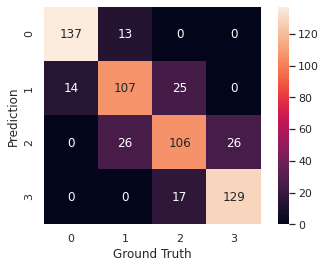

In [ ]:
sns.set()

# Initialise the Gaussian Classifier
model = GaussianNB()

# Train the model 
model.fit(X_train, y_train)

# Predict Output 
pred = model.predict(X_test)

# Plot Confusion Matrix
from sklearn.metrics import confusion_matrix
from sklearn.naive_bayes import GaussianNB
mat = confusion_matrix(pred, y_test)
names = np.unique(pred)
sns.heatmap(mat, square=True, annot=True, fmt='d', cbar=True,
            xticklabels=names, yticklabels=names)
plt.xlabel('Ground Truth')
plt.ylabel('Prediction')

The summary of predictions,confusion matrix, accuracy score, log loss of NB model and bar plot.

              precision    recall  f1-score   support

           0       0.91      0.91      0.91       151
           1       0.73      0.73      0.73       146
           2       0.67      0.72      0.69       148
           3       0.88      0.83      0.86       155

    accuracy                           0.80       600
   macro avg       0.80      0.80      0.80       600
weighted avg       0.80      0.80      0.80       600

[[137  14   0   0]
 [ 13 107  26   0]
 [  0  25 106  17]
 [  0   0  26 129]]
accuracy is 0.7983333333333333


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       151
           1       0.44      0.41      0.43       146
           2       0.37      0.32      0.34       148
           3       0.56      0.64      0.60       155

    accuracy                           0.54       600
   macro avg       0.53      0.54      0.53       600
weighted avg       0.53      0.54      0.53       600

[[119  24   7   1]
 

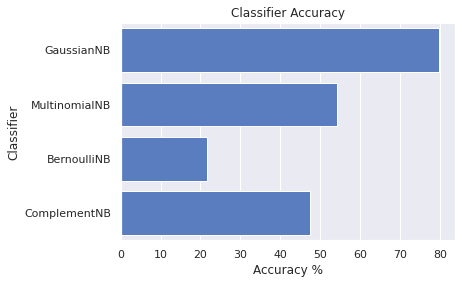

In [ ]:
classifiers = [
    GaussianNB(),
    MultinomialNB(),
    BernoulliNB(),
    ComplementNB(),               
                  ]
 
for clf in classifiers:
  clf.fit(X_train, y_train)
 
  y_pred = clf.predict(X_test)
 
# Summary of the predictions made by the classifier
  print(classification_report(y_test, y_pred))
  print(confusion_matrix(y_test, y_pred))
# Accuracy score
  print('accuracy is',accuracy_score(y_pred,y_test))
  print('\n')


# Logging for Visual Comparison
log_cols=["Classifier", "Accuracy", "Log Loss"]
log = pd.DataFrame(columns=log_cols)
 
for clf in classifiers:
    clf.fit(X_train, y_train)
    name = clf.__class__.__name__
    
    print("="*30)
    print(name)
    
    print('****Results****')
    train_predictions = clf.predict(X_test)
    acc = accuracy_score(y_test, train_predictions)
    print("Accuracy: {:.4%}".format(acc))
    
    train_predictions = clf.predict_proba(X_test)
    ll = log_loss(y_test, train_predictions)
    print("Log Loss: {}".format(ll))
    log_entry = pd.DataFrame([[name, acc*100, ll]], columns=log_cols)
    log = log.append(log_entry)
    
    print("="*30)

sns.set_color_codes("muted")
sns.barplot(x='Accuracy', y='Classifier', data=log, color="b")
 
plt.xlabel('Accuracy %')
plt.title('Classifier Accuracy')
plt.show()

####**K-Nearest Neighbours (KNN)**

In [ ]:
#Function to find the best value of k (1-100)
# Fit the K-nearest neighbors model with different values of k
# Store the accuracy measurement for each k

def find_best_k(Xtrain, ytrain, Xtest, ytest):
    score_list = list()

    for k in range(1, 100):
        # use k as variable to learn k-nn model ranging from 1 to 100
        knn_Trial = KNeighborsClassifier(n_neighbors = k)
        knn_Trial = knn_Trial.fit(Xtrain, ytrain)
        y_pred = knn_Trial.predict(Xtest)
        score = metrics.accuracy_score(ytest, y_pred)
        # append the accuracies in score_list
        score_list.append((k, score))
    return score_list

In [ ]:
def plot_k_accuracy(df):
  fig = plt.figure()
  ax = plt.axes()
  ax.plot(score_df.k, score_df.accuracy)
  plt.xlabel("k")
  plt.ylabel("accuracy")

In [ ]:
def conf_mat(pred):
  cfm = confusion_matrix(y_test, pred)
  lbl = np.unique(pred)

  plot = sns.heatmap(cfm, annot=True, fmt='d',xticklabels=lbl,yticklabels=lbl);
  plt.xlabel("Ground Truth")
  plt.ylabel("Prediction")

  print(classification_report(y_test,pred)) 

k           9.000000
accuracy    0.936667
Name: 8, dtype: float64

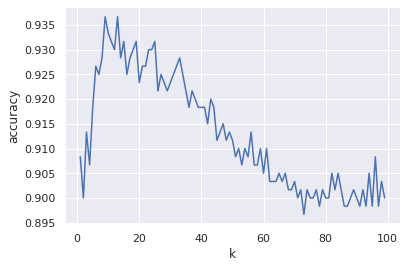

In [ ]:
#KNN without scaling 
scoreList=find_best_k(X_train, y_train, X_test, y_test)

score_df = pd.DataFrame(scoreList, columns=['k', 'accuracy'])

plot_k_accuracy(score_df)

score_df.iloc[score_df['accuracy'].idxmax()]

We get that the best k value is 9, with an accuracy of approximately 93.67%

              precision    recall  f1-score   support

           0       0.97      0.97      0.97       151
           1       0.89      0.95      0.92       146
           2       0.92      0.88      0.90       148
           3       0.97      0.94      0.95       155

    accuracy                           0.94       600
   macro avg       0.94      0.94      0.94       600
weighted avg       0.94      0.94      0.94       600



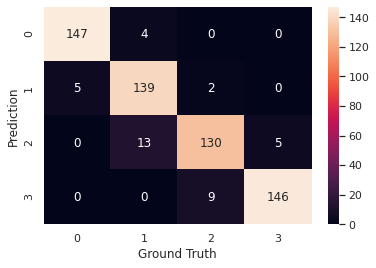

In [ ]:
knn = KNeighborsClassifier(n_neighbors=9)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)
conf_mat(y_pred)

Next, we will try KNN using scaled or mormalised data and see how the results compare to the previous model.

1. Standard Scaling

k           94.000
accuracy     0.655
Name: 93, dtype: float64

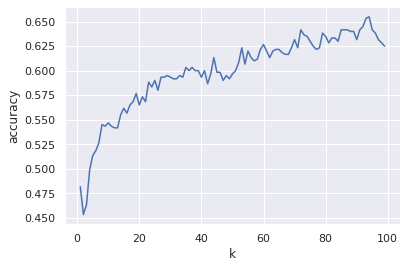

In [ ]:
stdscaler = StandardScaler()
X_train_std = stdscaler.fit_transform(X_train)
X_test_std = stdscaler.transform(X_test)

scoreList=find_best_k(X_train_std, y_train, X_test_std, y_test)

score_df = pd.DataFrame(scoreList, columns=['k', 'accuracy'])

plot_k_accuracy(score_df)

score_df.iloc[score_df['accuracy'].idxmax()]

              precision    recall  f1-score   support

           0       0.74      0.72      0.73       151
           1       0.53      0.62      0.57       146
           2       0.56      0.61      0.59       148
           3       0.86      0.67      0.75       155

    accuracy                           0.66       600
   macro avg       0.67      0.65      0.66       600
weighted avg       0.68      0.66      0.66       600



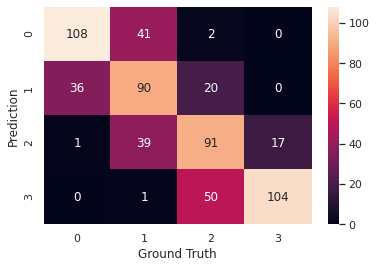

In [ ]:
knn = KNeighborsClassifier(n_neighbors=94)
knn.fit(X_train_std, y_train)
y_pred = knn.predict(X_test_std)
conf_mat(y_pred)

2. Min Max Scaling

k           75.000000
accuracy     0.553333
Name: 74, dtype: float64

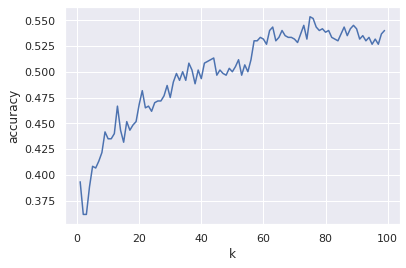

In [ ]:
mmscaler = MinMaxScaler()
X_train_mms = mmscaler.fit_transform(X_train)
X_test_mms = mmscaler.transform(X_test)

scoreList=find_best_k(X_train_mms, y_train, X_test_mms, y_test)

score_df = pd.DataFrame(scoreList, columns=['k', 'accuracy'])

plot_k_accuracy(score_df)

score_df.iloc[score_df['accuracy'].idxmax()]

              precision    recall  f1-score   support

           0       0.65      0.68      0.66       151
           1       0.41      0.42      0.41       146
           2       0.45      0.51      0.48       148
           3       0.77      0.59      0.67       155

    accuracy                           0.55       600
   macro avg       0.57      0.55      0.56       600
weighted avg       0.57      0.55      0.56       600



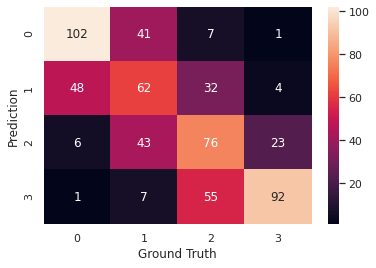

In [ ]:
knn = KNeighborsClassifier(n_neighbors=75)
knn.fit(X_train_mms, y_train)
y_pred = knn.predict(X_test_mms)
conf_mat(y_pred)

3. Robust Scaling

k           94.00
accuracy     0.66
Name: 93, dtype: float64

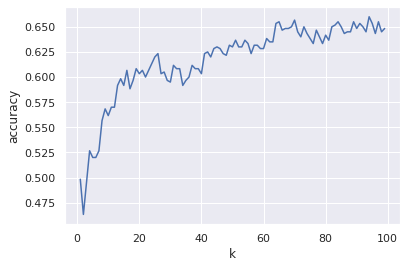

In [ ]:
rscaler = RobustScaler()
X_train_rs = rscaler.fit_transform(X_train)
X_test_rs = rscaler.transform(X_test)

scoreList=find_best_k(X_train_rs, y_train, X_test_rs, y_test)

score_df = pd.DataFrame(scoreList, columns=['k', 'accuracy'])

plot_k_accuracy(score_df)

score_df.iloc[score_df['accuracy'].idxmax()]

              precision    recall  f1-score   support

           0       0.62      0.62      0.62       151
           1       0.38      0.42      0.40       146
           2       0.44      0.49      0.46       148
           3       0.76      0.60      0.67       155

    accuracy                           0.53       600
   macro avg       0.55      0.53      0.54       600
weighted avg       0.55      0.53      0.54       600



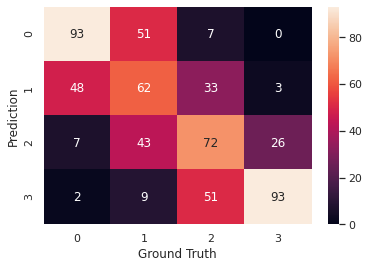

In [ ]:
knn = KNeighborsClassifier(n_neighbors=94)
knn.fit(X_train_mms, y_train)
y_pred = knn.predict(X_test_mms)
conf_mat(y_pred)

We observe that occasionally, normalising data may remove some important feature differences, which causes accuracy to decrease. However, there are times when it aids in reducing or getting rid of noise in the features which cause incorrect classifications. 

We can conclude for this case, normalisation was unecessary; from the data visualisation above we can also see that almost no two features (as in X columns)are highly correlated. The raw data is sufficent to use to produce a decent KNN classifier with 94% accuracy score using k = 9.

####**Support Vector Machine (SVM)**

For SVM, first we have to scale the data

In [ ]:
x_cols = [x for x in data.columns if x != 'price_range']
y = data['price_range']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

#non-scaler, stander scaler and minmaxscaler.
X_train_non = X_train
X_test_non = X_test

mms = MinMaxScaler()
X_train_mms = mms.fit_transform(X_train)
X_test_mms = mms.transform(X_test)

std = StandardScaler()
X_train_std = std.fit_transform(X_train)
X_test_std = std.transform(X_test)

Fit the whole dataset that scaled using StandardScaler MinMaxScaler or non-scaler to LinearSVC and see the accuracy obtained.<br>
Accuracy with Standard Scaler

In [ ]:
LinSVC = LinearSVC()
LinSVC.fit(X_train, y_train)

print("Train accuracy:",LinSVC.score(X_train, y_train))
print("Test accuracy:",LinSVC.score(X_test, y_test))

Train accuracy: 0.8742857142857143
Test accuracy: 0.8433333333333334


Accuracy with Min Max Scaler

In [ ]:
LinSVC1 = LinearSVC()
LinSVC1.fit(X_train_mms, y_train)

print("Train accuracy:",LinSVC1.score(X_train_mms, y_train))
print("Test accuracy:",LinSVC1.score(X_test_mms, y_test))

Train accuracy: 0.8428571428571429
Test accuracy: 0.8116666666666666


Accuracy with non scaler

In [ ]:
LinSVC2 = LinearSVC()
LinSVC2.fit(X_train_non, y_train)

print("Train accuracy:",LinSVC2.score(X_train_non, y_train))
print("Test accuracy:",LinSVC2.score(X_test_non, y_test))

Train accuracy: 0.5107142857142857
Test accuracy: 0.5133333333333333


The result shows that the best scaler for SVM is Standard Scaler with test accuracy of 0.84.<br>
We can see the accuracy is only 0.84 which is not so good.<br>
Now we try to find the best SVC models by using different parameters.

In [ ]:
x_cols = [x for x in data.columns if x != 'price_range']
y = data['price_range']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_train = pd.DataFrame(X_train, columns=['%s_scaled' % x for x in x_cols])

X_test = scaler.transform(X_test)
X_test = pd.DataFrame(X_test, columns=['%s_scaled' % x for x in x_cols])

We have to check whether the feature columns of scaled dataset same with original dataset.

In [ ]:
print(X_train.columns)
print(data[x_cols].columns)

Index(['battery_power_scaled', 'blue_scaled', 'clock_speed_scaled',
       'dual_sim_scaled', 'fc_scaled', 'four_g_scaled', 'int_memory_scaled',
       'm_dep_scaled', 'mobile_wt_scaled', 'n_cores_scaled', 'pc_scaled',
       'px_height_scaled', 'px_width_scaled', 'ram_scaled', 'sc_h_scaled',
       'sc_w_scaled', 'talk_time_scaled', 'three_g_scaled',
       'touch_screen_scaled', 'wifi_scaled'],
      dtype='object')
Index(['battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc', 'four_g',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'three_g',
       'touch_screen', 'wifi'],
      dtype='object')


Tuning parameters using GridSearchCV. 

In [ ]:
#set the parameters by cross-validation
param_grid = [{'kernel':['rbf'],'gamma':['auto'],
              'C': [1, 10, 100, 1000]},
              {'kernel':['linear'], 'C':[1, 10, 100, 200]}]

scores = ['accuracy','precision_macro','recall_macro']

for score in scores:
    print("# Tuning hyper-parameters for %s" %score)
    print()
    GR = GridSearchCV(SVC(), param_grid, cv=5,   
                      scoring='%s' %score) #cv, cross validation=5
    GR.fit(X_train, y_train)
    
    print("Best parameters set found on development set:")
    print()
    print(GR.best_params_)
    print()
    print("Grid score on development set:")
    print()
    means = GR.cv_results_['mean_test_score']
    stds = GR.cv_results_['std_test_score']
    for mean, std, params in zip(means, stds, GR.cv_results_['params']):
        print("%0.3f (+/-%0.03f) for%r"
              % (mean,std*2,params))
        
    print()
    print("Detailed classification report")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print("-----------------------------------------------------------------------------------------")

# Tuning hyper-parameters for accuracy

Best parameters set found on development set:

{'C': 100, 'kernel': 'linear'}

Grid score on development set:

0.861 (+/-0.038) for{'C': 1, 'gamma': 'auto', 'kernel': 'rbf'}
0.854 (+/-0.030) for{'C': 10, 'gamma': 'auto', 'kernel': 'rbf'}
0.854 (+/-0.030) for{'C': 100, 'gamma': 'auto', 'kernel': 'rbf'}
0.854 (+/-0.030) for{'C': 1000, 'gamma': 'auto', 'kernel': 'rbf'}
0.954 (+/-0.044) for{'C': 1, 'kernel': 'linear'}
0.958 (+/-0.029) for{'C': 10, 'kernel': 'linear'}
0.960 (+/-0.023) for{'C': 100, 'kernel': 'linear'}
0.955 (+/-0.022) for{'C': 200, 'kernel': 'linear'}

Detailed classification report

The model is trained on the full development set.
The scores are computed on the full evaluation set.
-----------------------------------------------------------------------------------------
# Tuning hyper-parameters for precision_macro

Best parameters set found on development set:

{'C': 100, 'kernel': 'linear'}

Grid score on development set:

0.867 (

The best parameters are C=100 with kernel=linear.<br>
Fit the model with training set and predict on the test set.<br>
The training time is printed out so that we can compare to the training time of the model that will be fitted with few selected features later.


In [ ]:
%%timeit
best_SVC = SVC(C=100, kernel='linear')
best_SVC.fit(X_train, y_train)

1 loop, best of 5: 231 ms per loop


Retrieve the accuracy score. 

We can see the test accuracy is 0.975, which is much more better than the accuracy of the first linear SVC model.

In [ ]:
best_SVC = SVC(C=100, kernel='linear')
best_SVC.fit(X_train, y_train)
y_pred = best_SVC.predict(X_test)

print("train accuracy:", best_SVC.score(X_train, y_train))
print("test accuracy:", best_SVC.score(X_test, y_test))

train accuracy: 0.9885714285714285
test accuracy: 0.975


Print out the classification report and confusion matrix.

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.97      0.98       151
           1       0.94      1.00      0.97       146
           2       0.98      0.95      0.97       148
           3       0.98      0.98      0.98       155

    accuracy                           0.97       600
   macro avg       0.98      0.98      0.97       600
weighted avg       0.98      0.97      0.98       600



<function matplotlib.pyplot.show>

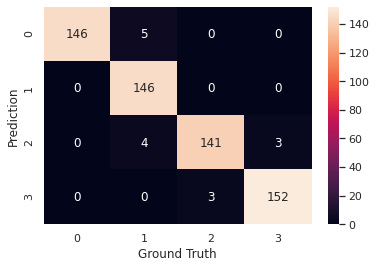

In [ ]:
cm = confusion_matrix(y_test, y_pred)

plot = sns.heatmap(cm, annot=True, fmt='d')
plt.xlabel("Ground Truth")
plt.ylabel("Prediction")
plt.show

####SVM with Features Selection

Feature selection is carried out to reduce the number of input variables when building a model. Feature selection can reduce the computational cost of a model by reducing the number of input variables and hence improve the performance of the model. The training time of the model will be shorten without affecting much on the accuracy.

By using SelectKbest from scikit-learn, find the best number of features(between 1 to 20) to train the SVM model.

During finding the best number of features, a simple Linear SVC is used to fit the data.

In [ ]:
svm = LinearSVC()
score_list = list()

for k in range(1, 21, 1):
    skbest = SelectKBest(f_classif, k)
    X_kbest = skbest.fit_transform(X_train, y_train)
    X_test_kbest = skbest.transform(X_test)
    svm.fit(X_kbest, y_train)
    y_pred = svm.predict(X_test_kbest)
    score = metrics.accuracy_score(y_test, y_pred)
    # append the accuracies in score_list
    score_list.append((k, score))
    
score_df = pd.DataFrame(score_list, columns=['k', 'accuracy'])

By plotting the graph  below and retrieve the information, we can see that the best number is 4 with 0.84 of accuracy.

No handles with labels found to put in legend.


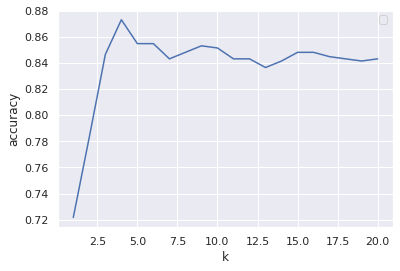

In [ ]:
import matplotlib.pyplot as plt

fig = plt.figure()
ax = plt.axes()

ax.plot(score_df.k, score_df.accuracy)
plt.xlabel("k")
plt.ylabel("accuracy")
plt.legend()

In [ ]:
score_df.iloc[score_df['accuracy'].idxmax()]

k           4.000000
accuracy    0.873333
Name: 3, dtype: float64

Now retrieve the 4 features selected by selectKbest.

In [ ]:
selector = SelectKBest(f_classif, k=4)
X_train_new = selector.fit_transform(X_train, y_train)
X_test_new = selector.transform(X_test)

features_name = X_train.columns.values[selector.get_support()]

print("The four features selected are:")
for each in features_name:
    print(each[0:-7])

The four features selected are:
battery_power
px_height
px_width
ram


The 4 features selected by SelectKbest are the features that have highest correlation score to the target variable 'price_range'.

In [ ]:
#set the parameters by cross-validation
param_grid = [{'kernel':['rbf'],'gamma':['auto'],
              'C': [1, 10, 100, 1000]},
              {'kernel':['linear'], 'C':[1, 10, 100, 200]}]

scores = ['accuracy','precision_macro','recall_macro']

for score in scores:
    print("# Tuning hyper-parameters for %s" %score)
    print()
    GR = GridSearchCV(SVC(), param_grid, cv=5,   
                      scoring='%s' %score) #cv, cross validation=5
    GR.fit(X_train_new, y_train)
    
    print("Best parameters set found on development set:")
    print()
    print(GR.best_params_)
    print()
    print("Grid score on development set:")
    print()
    means = GR.cv_results_['mean_test_score']
    stds = GR.cv_results_['std_test_score']
    for mean, std, params in zip(means, stds, GR.cv_results_['params']):
        print("%0.3f (+/-%0.03f) for%r"
              % (mean,std*2,params))
        
    print()
    print("Detailed classification report")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print("-----------------------------------------------------------------------------------------")

# Tuning hyper-parameters for accuracy

Best parameters set found on development set:

{'C': 100, 'kernel': 'linear'}

Grid score on development set:

0.931 (+/-0.032) for{'C': 1, 'gamma': 'auto', 'kernel': 'rbf'}
0.932 (+/-0.042) for{'C': 10, 'gamma': 'auto', 'kernel': 'rbf'}
0.934 (+/-0.047) for{'C': 100, 'gamma': 'auto', 'kernel': 'rbf'}
0.919 (+/-0.053) for{'C': 1000, 'gamma': 'auto', 'kernel': 'rbf'}
0.954 (+/-0.015) for{'C': 1, 'kernel': 'linear'}
0.955 (+/-0.023) for{'C': 10, 'kernel': 'linear'}
0.956 (+/-0.031) for{'C': 100, 'kernel': 'linear'}
0.955 (+/-0.034) for{'C': 200, 'kernel': 'linear'}

Detailed classification report

The model is trained on the full development set.
The scores are computed on the full evaluation set.
-----------------------------------------------------------------------------------------
# Tuning hyper-parameters for precision_macro

Best parameters set found on development set:

{'C': 100, 'kernel': 'linear'}

Grid score on development set:

0.933 (

The best parameters are C=100 with kernel=linear..
Fit the data and train the model.

The training time is much more lower than the SVC model trained with full dataset.

In [ ]:
%%timeit
best_SVC = SVC(C=100, kernel='linear')
best_SVC.fit(X_train_new, y_train)

10 loops, best of 5: 32.2 ms per loop


Retrieve the accuracy score.<br>
Compare to SVC trained by full dataset, although the test accuracy dropped a little bit, but it has advantages in term of training time.

In [ ]:
best_SVC = SVC(C=100, kernel='linear')
best_SVC.fit(X_train_new, y_train)
y_pred = best_SVC.predict(X_test_new)

print("train accuracy:", best_SVC.score(X_train_new, y_train))
print("test accuracy:", best_SVC.score(X_test_new, y_test))

train accuracy: 0.9614285714285714
test accuracy: 0.965


*Print* the classification report and confusion matrix.

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.96      0.98       151
           1       0.93      0.99      0.96       146
           2       0.95      0.95      0.95       148
           3       0.98      0.96      0.97       155

    accuracy                           0.96       600
   macro avg       0.97      0.97      0.96       600
weighted avg       0.97      0.96      0.97       600



<function matplotlib.pyplot.show>

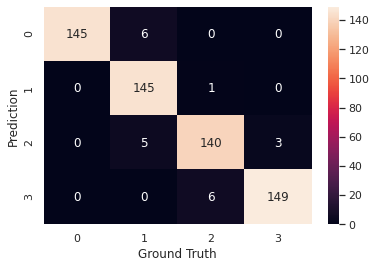

In [ ]:
cm = confusion_matrix(y_test, y_pred)

plot = sns.heatmap(cm, annot=True, fmt='d')
plt.xlabel("Ground Truth")
plt.ylabel("Prediction")
plt.show

####Voting Classifier
Now, try to improve the accuracy of the models by using VotingClassifier. <br>
Fit the Classifier to the full dataset.<br>
The another model we choose is a LogisticRegressionCV model that give highest accuracy. 

In [ ]:
x_cols = [x for x in data.columns if x != 'price_range']

# Split the data into two dataframes
X = data[x_cols] 
y = data['price_range']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_train = pd.DataFrame(X_train, columns=['%s_scaled' % x for x in x_cols])

X_test = scaler.transform(X_test)
X_test = pd.DataFrame(X_test, columns=['%s_scaled' % x for x in x_cols])

lr_l3 = LogisticRegressionCV(Cs=10, cv=4, penalty='l2', solver='newton-cg').fit(X_train, y_train)
svm = SVC(C=100, kernel='linear',probability=True)

              precision    recall  f1-score   support

           0       1.00      0.97      0.98       151
           1       0.93      0.99      0.96       146
           2       0.97      0.93      0.95       148
           3       0.97      0.98      0.98       155

    accuracy                           0.97       600
   macro avg       0.97      0.97      0.97       600
weighted avg       0.97      0.97      0.97       600



<function matplotlib.pyplot.show>

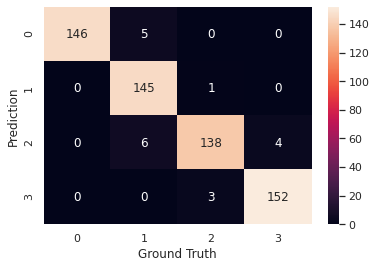

In [ ]:
estimators =[('LR', lr_l3),('SVM',svm)]

VC = VotingClassifier(estimators, voting='soft')
VC = VC.fit(X_train, y_train)  

y_pred = VC.predict(X_test)
print(classification_report(y_test, y_pred))

cm = confusion_matrix(y_test, y_pred)
plot = sns.heatmap(cm, annot=True, fmt='d')
plt.xlabel("Ground Truth")
plt.ylabel("Prediction")
plt.show

We can see that the precision for class 1, 2 and 3 drop a little bit.<br>
Since we use voting='soft' which means make prediction through compare the probability, then the drop of precision may because of a model predict a wrong class with a higher probabilty compare to the other model predict a correct class.

####**Logistic Regression**

In [ ]:
# Get the split indexes
strat_shuf_split = StratifiedShuffleSplit(n_splits=5,test_size=0.3, random_state=42)

feature_cols = data.columns[:-1]

train_idx, test_idx = next(strat_shuf_split.split(data[feature_cols], data.price_range))

# Create the dataframes
X_train = data.loc[train_idx, feature_cols]
y_train = data.loc[train_idx, 'price_range']

X_test  = data.loc[test_idx, feature_cols]
y_test  = data.loc[test_idx, 'price_range']

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV

solver_list = ['liblinear', 'newton-cg', 'lbfgs', 'sag', 'saga']
params = dict(solver=solver_list)
log_reg = LogisticRegression(C=1, n_jobs=-1, random_state=34)
clf = GridSearchCV(log_reg, params, cv=5)
clf.fit(X_train, y_train)
scores = clf.cv_results_['mean_test_score']

for score, solver in zip(scores, solver_list):
    print(f"  {solver} {score:.3f}" )

  liblinear 0.760
  newton-cg 0.951
  lbfgs 0.642
  sag 0.645
  saga 0.634


We can see that 'newton-cg' solver yields the highest score

In [ ]:
# Standard logistic regression
lr = LogisticRegression().fit(X_train, y_train)

# L1 regularized logistic regression
lr_l1 = LogisticRegressionCV(Cs=10, cv=4, penalty='l1', solver='liblinear').fit(X_train, y_train)

# L2 regularized logistic regression
lr_l2 = LogisticRegressionCV(Cs=10, cv=4, penalty='l2').fit(X_train, y_train)

#A newton method
lr_l3 = LogisticRegressionCV(Cs=10, cv=4, penalty='l2', solver='newton-cg').fit(X_train, y_train)

#Limited-memory Broyden_fletcher-Goldfarb-Shanno
lr_l4 = LogisticRegressionCV(Cs=10, cv=4, penalty='l2', solver='lbfgs').fit(X_train, y_train)

#Stochastic Average Gradient descent
lr_l5 = LogisticRegressionCV(Cs=10, cv=4, penalty='l2', solver='sag').fit(X_train, y_train)

#Extension of sag that also allows for L1 regularization.
lr_l6 = LogisticRegressionCV(Cs=10, cv=4, penalty='l1', solver='saga').fit(X_train, y_train)

In [ ]:
# Combine all the coefficients into a dataframe
coefficients = list()

coeff_labels = ['lr', 'l1', 'l2','l3','l4','l5','l6']
coeff_models = [lr, lr_l1, lr_l2, lr_l3, lr_l4, lr_l5, lr_l6]

for lab,mod in zip(coeff_labels, coeff_models):
    coeffs = mod.coef_
    coeff_label = pd.MultiIndex(levels=[[lab], [0,1,2,3]], 
                                codes=[[0,0,0,0], [0,1,2,3]])
    coefficients.append(pd.DataFrame(coeffs.T, columns=coeff_label))

coefficients = pd.concat(coefficients, axis=1)

coefficients.sample(10)

lr                      ...        l6                    
           0         1         2  ...         1         2         3
7   0.000169  0.000169 -0.000125  ...  0.000425 -0.000329 -0.000467
3   0.000224  0.000121 -0.000063  ...  0.000323 -0.000120 -0.000764
13 -0.004241 -0.000819  0.001683  ... -0.000727  0.001598  0.003347
0  -0.000512  0.000074  0.000206  ...  0.000080  0.000192  0.000423
17  0.000376  0.000093 -0.000070  ...  0.000141 -0.000082 -0.001006
10  0.004694  0.000309 -0.000786  ... -0.000571 -0.001822 -0.011382
18  0.000290  0.000166 -0.000245  ...  0.000430 -0.000718 -0.000438
14  0.005841  0.001778 -0.001903  ...  0.005423 -0.004842 -0.017452
15  0.002634  0.000542 -0.000106  ...  0.000933  0.001021 -0.009231
12  0.001227  0.000625 -0.000583  ...  0.000540 -0.000486 -0.000909

[10 rows x 28 columns]

To gain a better visualisation of the coeeficients for each solver, we prepare four seperate plots

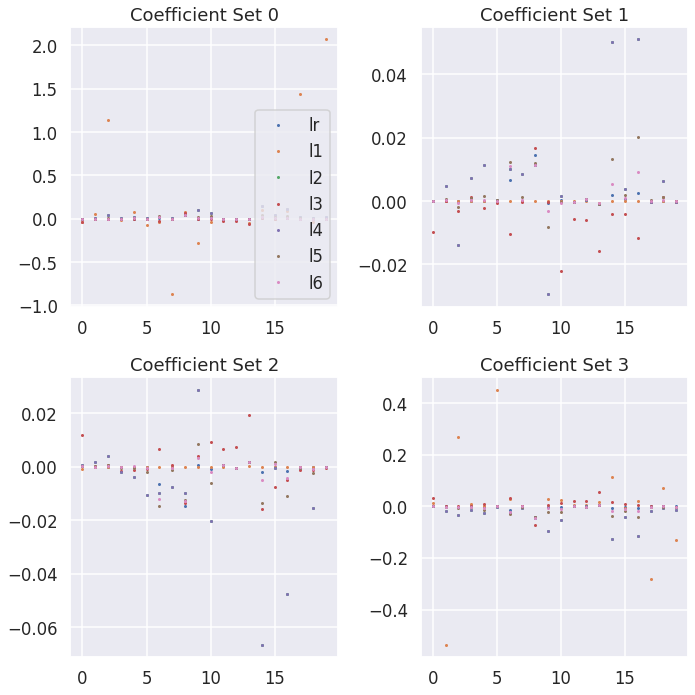

In [ ]:
fig, axList = plt.subplots(nrows=2, ncols=2)
axList = axList.flatten()
fig.set_size_inches(10,10)


for ax in enumerate(axList):
    loc = ax[0]
    ax = ax[1]
    
    data_coeff = coefficients.xs(loc, level=1, axis=1)
    data_coeff.plot(marker='o', ls='', ms=2.0, ax=ax, legend=False)
    
    if ax is axList[0]:
        ax.legend(loc=4)
        
    ax.set(title='Coefficient Set '+str(loc))

plt.tight_layout()

In [ ]:
# Predict the class and the probability for each

y_pred = list()
y_prob = list()

coeff_labels = ['lr', 'l1', 'l2','l3','l4','l5','l6']
coeff_models = [lr, lr_l1, lr_l2, lr_l3, lr_l4, lr_l5, lr_l6]

for lab,mod in zip(coeff_labels, coeff_models):
    y_pred.append(pd.Series(mod.predict(X_test), name=lab))
    y_prob.append(pd.Series(mod.predict_proba(X_test).max(axis=1), name=lab))
    
y_pred = pd.concat(y_pred, axis=1)
y_prob = pd.concat(y_prob, axis=1)

y_pred.head()

,lr,l1,l2,l3,l4,l5,l6
0,3,3,3,3,3,3,3
1,3,3,3,3,3,3,3
2,2,2,2,1,2,2,2
3,3,2,2,1,2,3,3
4,2,3,2,3,2,2,2


In [ ]:
y_prob.head()

,lr,l1,l2,l3,l4,l5,l6
0,0.521262,0.703431,0.775630,1.000000,0.775630,0.659345,0.599891
1,0.899385,0.587159,0.928644,0.997703,0.928644,0.900755,0.890806
2,0.491358,0.546766,0.599664,0.979777,0.599664,0.494444,0.475668
3,0.578198,0.648283,0.561941,0.999987,0.561941,0.465144,0.530028
4,0.541164,0.747468,0.452125,1.000000,0.452125,0.504592,0.504390


In [ ]:
metrics = list()
cm = dict()

for lab in coeff_labels:

    # Precision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = prfscore(y_test, y_pred[lab], average='weighted')
    
    # The usual way to calculate accuracy
    accuracy = accuracy_score(y_test, y_pred[lab])
    
    # ROC-AUC scores can be calculated by binarizing the data
    auc = roc_auc_score(label_binarize(y_test, classes=[0,1,2,3]),
              label_binarize(y_pred[lab], classes=[0,1,2,3]), 
              average='weighted')
    
    # Last, the confusion matrix
    cm[lab] = confusion_matrix(y_test, y_pred[lab])
    
    metrics.append(pd.Series({'precision':precision, 'recall':recall, 
                              'fscore':fscore, 'accuracy':accuracy,
                              'auc':auc}, 
                             name=lab))

metrics = pd.concat(metrics, axis=1)

#Run the metrics
metrics

,lr,l1,l2,l3,l4,l5,l6
precision,0.616944,0.812842,0.685907,0.983421,0.685907,0.654611,0.636936
recall,0.618333,0.811667,0.678333,0.983333,0.678333,0.655000,0.638333
fscore,0.617089,0.809004,0.681367,0.983366,0.681367,0.654596,0.637156
accuracy,0.618333,0.811667,0.678333,0.983333,0.678333,0.655000,0.638333
auc,0.745556,0.874444,0.785556,0.988889,0.785556,0.770000,0.758889


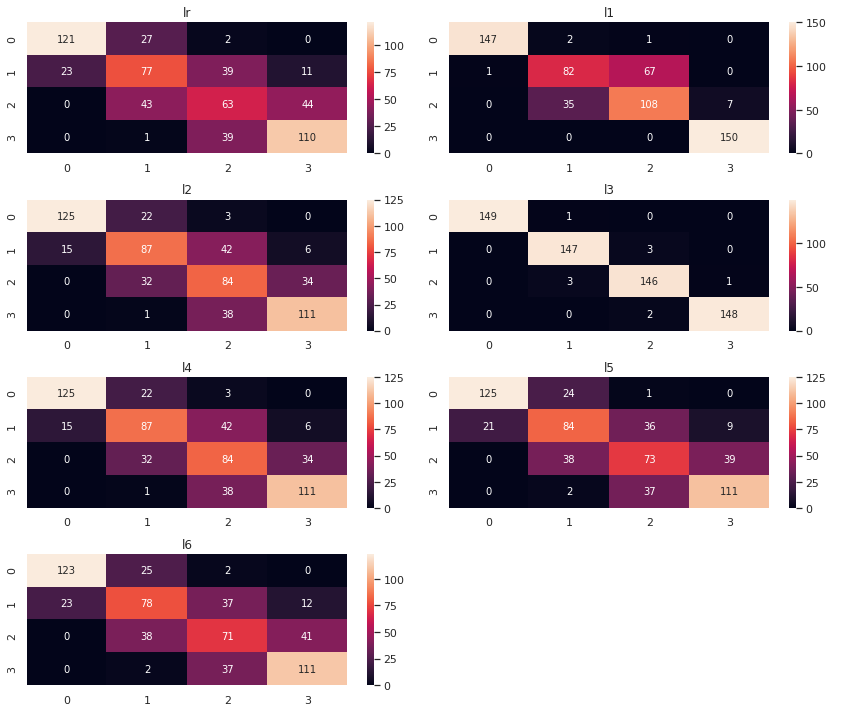

In [ ]:
fig, axList = plt.subplots(nrows=4, ncols=2)
axList = axList.flatten()
fig.set_size_inches(12, 10)

axList[-1].axis('off')

for ax,lab in zip(axList[:-1], coeff_labels):
    sns.heatmap(cm[lab], ax=ax, annot=True, fmt='d');
    ax.set(title=lab);
    
plt.tight_layout()

We observe that the implementation of Voting Classifier improved the accuracy of l3 solver.

              precision    recall  f1-score   support

           0       1.00      0.99      0.99       150
           1       0.97      0.99      0.98       150
           2       0.97      0.98      0.98       150
           3       0.99      0.99      0.99       150

    accuracy                           0.98       600
   macro avg       0.99      0.98      0.99       600
weighted avg       0.99      0.98      0.99       600



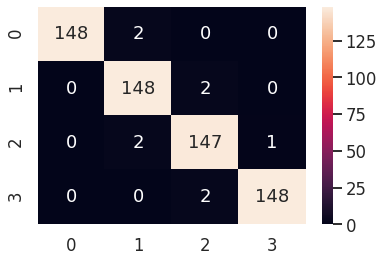

In [ ]:
estimators = [('l3', lr_l3), ('l1', lr_l1)]

VC = VotingClassifier(estimators, voting='soft')
VC = VC.fit(X_train, y_train)

y_pred = VC.predict(X_test)
print(classification_report(y_test, y_pred))

sns.set_context('talk')
cm = confusion_matrix(y_test, y_pred)
ax= sns.heatmap(cm, annot=True, fmt='d')

####**Neural Network (NN)**

Split the dataset to X(features or predictor variables) and y(target variable).

In [ ]:
X = data.iloc[:,:20].values
y = data.iloc[:,20:21].values
y[0:10]

array([[1],
       [2],
       [2],
       [2],
       [1],
       [1],
       [3],
       [0],
       [0],
       [0]])

One Hot Encode the target variable. Then print out to check the encoded data.


In [ ]:
ohc = OneHotEncoder()
y = ohc.fit_transform(y).toarray()
print(y[0:10])

[[0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 0. 1.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]]


We have to scale the data by using standard Scaler.

In [ ]:
x_cols = [x for x in data.columns if x != 'price_range']
X = data[x_cols] 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_train = pd.DataFrame(X_train, columns=['%s_scaled' % x for x in x_cols])

X_test = scaler.transform(X_test)
X_test = pd.DataFrame(X_test, columns=['%s_scaled' % x for x in x_cols])

Build a NN model with 20 input neurons, 1 hidden layer with 12 hidden neurons and 4 output neurons.

In [ ]:
model = Sequential()
model.add(Dense(12, input_dim=20, activation='relu'))
model.add(Dense(4, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 12)                252       
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 52        
Total params: 304
Trainable params: 304
Non-trainable params: 0
_________________________________________________________________


Since We have 4 classes to predict, 'categorical_crossentropy' should be used and the labels must in one_hot representation. The optimizer choosen is 'adam' and performance metric is accuracy.<br>
Fit the scaled X data and one_hot encoded y data into the model and train with 200 epochs.

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=200)

Epoch 1/200
44/44 [==============================] - 1s 8ms/step - loss: 1.4370 - accuracy: 0.3381 - val_loss: 1.3759 - val_accuracy: 0.3917
Epoch 2/200
44/44 [==============================] - 0s 2ms/step - loss: 1.3506 - accuracy: 0.3655 - val_loss: 1.3045 - val_accuracy: 0.4167
Epoch 3/200
44/44 [==============================] - 0s 3ms/step - loss: 1.2984 - accuracy: 0.3700 - val_loss: 1.2487 - val_accuracy: 0.4500
Epoch 4/200
44/44 [==============================] - 0s 3ms/step - loss: 1.2260 - accuracy: 0.4242 - val_loss: 1.1980 - val_accuracy: 0.4700
Epoch 5/200
44/44 [==============================] - 0s 2ms/step - loss: 1.1696 - accuracy: 0.4610 - val_loss: 1.1465 - val_accuracy: 0.5133
Epoch 6/200
44/44 [==============================] - 0s 3ms/step - loss: 1.1226 - accuracy: 0.4883 - val_loss: 1.0950 - val_accuracy: 0.5333
Epoch 7/200
44/44 [==============================] - 0s 3ms/step - loss: 1.0628 - accuracy: 0.5274 - val_loss: 1.0415 - val_accuracy: 0.5700
Epoch 8/200
4

Plot the accuracy and loss for training and testing.

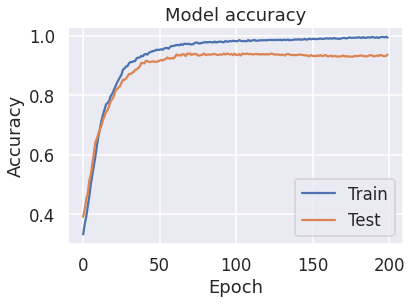

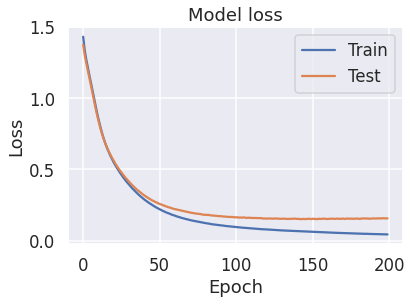

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')

plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='lower right')
plt.show()

plt.plot(history.history['loss']) 
plt.plot(history.history['val_loss']) 
plt.title('Model loss') 
plt.ylabel('Loss') 
plt.xlabel('Epoch') 
plt.legend(['Train', 'Test'], loc='upper right') 
plt.show()

Next, we predict the output of X_test, convert it back to the label(1, 2, 3 and 4), then print the classification report and confusion matrix.

              precision    recall  f1-score   support

           0       0.97      0.94      0.95       151
           1       0.91      0.96      0.93       146
           2       0.94      0.90      0.92       148
           3       0.94      0.95      0.94       155

    accuracy                           0.94       600
   macro avg       0.94      0.94      0.94       600
weighted avg       0.94      0.94      0.94       600



<function matplotlib.pyplot.show>

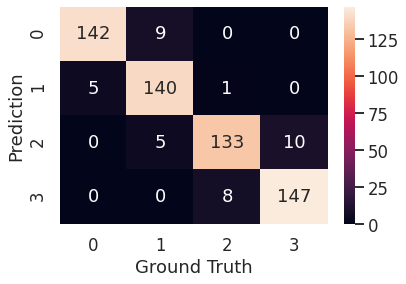

In [ ]:
y_pred = model.predict(X_test)

#Converting predictions to label
pred = list()
for i in range(len(y_pred)):
    pred.append(np.argmax(y_pred[i]))
    
#Converting one hot encoded test label to label
test = list()
for i in range(len(y_test)):
    test.append(np.argmax(y_test[i]))
    
    
print(classification_report(test,pred))

cm = confusion_matrix(test, pred)

plot = sns.heatmap(cm, annot=True, fmt='d')
plt.xlabel("Ground Truth")
plt.ylabel("Prediction")
plt.show

Now try to improve the test accuracy by tuning parameters for batch size, epochs, optimizer, learning rate and initial weights.

####Tuning Parameters for batch_size and epochs

In [ ]:
def NN_model():
    model1 = Sequential()
    model1.add(Dense(12, input_dim=20, activation='relu'))
    model1.add(Dense(4, activation='softmax'))
    model1.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model1

model = KerasClassifier(build_fn=NN_model, verbose=2)

batch_size = [10, 20, 32, 40, 60, 80, 100]
epochs = [10, 50, 100, 200]
param_grid = dict(batch_size=batch_size, epochs=epochs)

GVC_NN = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=5)
grid_result = GVC_NN.fit(X_train, y_train, validation_data=(X_test, y_test))

print("\n")
print("Best parameters: ", grid_result.best_params_, "with score: ", grid_result.best_score_)
print("")
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']

for x, y, z in zip(means, stds, params):
    print("Score of ", z, ": ", x, " +- ", y)

Epoch 1/200
35/35 - 1s - loss: 1.5677 - accuracy: 0.2664 - val_loss: 1.5121 - val_accuracy: 0.2650
Epoch 2/200
35/35 - 0s - loss: 1.4505 - accuracy: 0.3093 - val_loss: 1.4221 - val_accuracy: 0.2967
Epoch 3/200
35/35 - 0s - loss: 1.3633 - accuracy: 0.3493 - val_loss: 1.3508 - val_accuracy: 0.3383
Epoch 4/200
35/35 - 0s - loss: 1.2915 - accuracy: 0.3907 - val_loss: 1.2857 - val_accuracy: 0.3800
Epoch 5/200
35/35 - 0s - loss: 1.2249 - accuracy: 0.4286 - val_loss: 1.2259 - val_accuracy: 0.4083
Epoch 6/200
35/35 - 0s - loss: 1.1644 - accuracy: 0.4671 - val_loss: 1.1689 - val_accuracy: 0.4567
Epoch 7/200
35/35 - 0s - loss: 1.1070 - accuracy: 0.5000 - val_loss: 1.1141 - val_accuracy: 0.4933
Epoch 8/200
35/35 - 0s - loss: 1.0525 - accuracy: 0.5386 - val_loss: 1.0611 - val_accuracy: 0.5217
Epoch 9/200
35/35 - 0s - loss: 1.0007 - accuracy: 0.5779 - val_loss: 1.0119 - val_accuracy: 0.5483
Epoch 10/200
35/35 - 0s - loss: 0.9521 - accuracy: 0.6043 - val_loss: 0.9656 - val_accuracy: 0.5867
Epoch 11/

####Tuning Parameters for optimizer

In [ ]:
def NN_model(optimizer):
    model2 = Sequential()
    model2.add(Dense(12, input_dim=20, activation='relu'))
    model2.add(Dense(4, activation='softmax'))
    model2.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    return model2

model = KerasClassifier(build_fn=NN_model, epochs=200, batch_size=40, verbose=2)

optimizer = ['SGD', 'RMSprop', 'Adagrad', 'Adadelta', 'Adam', 'Adamax', 'Nadam']
param_grid = dict(optimizer=optimizer)

GVC_NN = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=5)
grid_result = GVC_NN.fit(X_train, y_train, validation_data=(X_test, y_test))

print("\n")
print("Best parameters: ", grid_result.best_params_, "with score: ", grid_result.best_score_)
print("")
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']

for x, y, z in zip(means, stds, params):
    print("Score of ", z, ": ", x, " +- ", y)

Epoch 1/200
35/35 - 1s - loss: 1.5887 - accuracy: 0.2329 - val_loss: 1.5084 - val_accuracy: 0.2600
Epoch 2/200
35/35 - 0s - loss: 1.4829 - accuracy: 0.2600 - val_loss: 1.4235 - val_accuracy: 0.2933
Epoch 3/200
35/35 - 0s - loss: 1.4016 - accuracy: 0.2986 - val_loss: 1.3581 - val_accuracy: 0.3317
Epoch 4/200
35/35 - 0s - loss: 1.3353 - accuracy: 0.3443 - val_loss: 1.3011 - val_accuracy: 0.3767
Epoch 5/200
35/35 - 0s - loss: 1.2768 - accuracy: 0.3864 - val_loss: 1.2489 - val_accuracy: 0.4183
Epoch 6/200
35/35 - 0s - loss: 1.2210 - accuracy: 0.4207 - val_loss: 1.1987 - val_accuracy: 0.4617
Epoch 7/200
35/35 - 0s - loss: 1.1669 - accuracy: 0.4607 - val_loss: 1.1488 - val_accuracy: 0.5017
Epoch 8/200
35/35 - 0s - loss: 1.1136 - accuracy: 0.4971 - val_loss: 1.1003 - val_accuracy: 0.5333
Epoch 9/200
35/35 - 0s - loss: 1.0614 - accuracy: 0.5450 - val_loss: 1.0523 - val_accuracy: 0.5567
Epoch 10/200
35/35 - 0s - loss: 1.0112 - accuracy: 0.5707 - val_loss: 1.0061 - val_accuracy: 0.5750
Epoch 11/

####Tuning Parameters for learning_rate of optimizer

In [ ]:
from keras.optimizers import Nadam

def NN_model(lr):
    model3 = Sequential()
    model3.add(Dense(12, input_dim=20, activation='relu'))
    model3.add(Dense(4, activation='softmax'))
    optimizer=Nadam(learning_rate=lr)
    model3.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    return model3

model = KerasClassifier(build_fn=NN_model, epochs=200, batch_size=40, verbose=2)

lr = [0.005, 0.001, 0.05, 0.01, 0.1, 0.2, 0.3]

param_grid = dict(lr=lr)
GVC_NN = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=5)
grid_result = GVC_NN.fit(X_train, y_train, validation_data=(X_test, y_test))

print("\n")
print("Best parameters: ", grid_result.best_params_, "with score: ", grid_result.best_score_)
print("")
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']

for x, y, z in zip(means, stds, params):
    print("Score of ", z, ": ", x, " +- ", y)

Epoch 1/200
35/35 - 1s - loss: 0.8955 - accuracy: 0.6336 - val_loss: 0.4619 - val_accuracy: 0.7717
Epoch 2/200
35/35 - 0s - loss: 0.5363 - accuracy: 0.7921 - val_loss: 0.8583 - val_accuracy: 0.7633
Epoch 3/200
35/35 - 0s - loss: 0.4470 - accuracy: 0.8193 - val_loss: 0.4229 - val_accuracy: 0.8417
Epoch 4/200
35/35 - 0s - loss: 0.4073 - accuracy: 0.8343 - val_loss: 0.5229 - val_accuracy: 0.7733
Epoch 5/200
35/35 - 0s - loss: 0.3594 - accuracy: 0.8400 - val_loss: 0.3353 - val_accuracy: 0.8317
Epoch 6/200
35/35 - 0s - loss: 0.4263 - accuracy: 0.8343 - val_loss: 0.6639 - val_accuracy: 0.8150
Epoch 7/200
35/35 - 0s - loss: 0.4189 - accuracy: 0.8271 - val_loss: 0.3157 - val_accuracy: 0.8517
Epoch 8/200
35/35 - 0s - loss: 0.4202 - accuracy: 0.8250 - val_loss: 0.5243 - val_accuracy: 0.8200
Epoch 9/200
35/35 - 0s - loss: 0.4538 - accuracy: 0.8350 - val_loss: 1.2203 - val_accuracy: 0.7550
Epoch 10/200
35/35 - 0s - loss: 0.4647 - accuracy: 0.8643 - val_loss: 0.3310 - val_accuracy: 0.8800
Epoch 11/

####Tuning Parameters for kernel_initializer(initial weights)

In [ ]:
def NN_model(init):
    model4 = Sequential()
    model4.add(Dense(12, input_dim=20, kernel_initializer=init, activation='relu'))
    model4.add(Dense(4, kernel_initializer=init, activation='softmax'))
    model4.compile(loss='categorical_crossentropy', optimizer=Nadam(learning_rate=0.3), metrics=['accuracy'])
    return model4

model = KerasClassifier(build_fn=NN_model, epochs=200, batch_size=40, verbose=2)

init = ['uniform', 'lecun_uniform', 'normal', 'zero', 'glorot_normal', 'glorot_uniform', 'he_normal', 'he_uniform']

param_grid = dict(init=init)
GVC_NN = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=5)
grid_result = GVC_NN.fit(X_train, y_train, validation_data=(X_test, y_test))

print("\n")
print("Best parameters: ", grid_result.best_params_, "with score: ", grid_result.best_score_)
print("")
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']

for x, y, z in zip(means, stds, params):
    print("Score of ", z, ": ", x, " +- ", y)

Epoch 1/200
35/35 - 1s - loss: 0.9617 - accuracy: 0.5771 - val_loss: 0.5191 - val_accuracy: 0.7817
Epoch 2/200
35/35 - 0s - loss: 0.5639 - accuracy: 0.7821 - val_loss: 0.3598 - val_accuracy: 0.8367
Epoch 3/200
35/35 - 0s - loss: 0.4588 - accuracy: 0.8171 - val_loss: 0.5951 - val_accuracy: 0.7833
Epoch 4/200
35/35 - 0s - loss: 0.3942 - accuracy: 0.8293 - val_loss: 0.4236 - val_accuracy: 0.8433
Epoch 5/200
35/35 - 0s - loss: 0.3602 - accuracy: 0.8443 - val_loss: 0.3750 - val_accuracy: 0.8400
Epoch 6/200
35/35 - 0s - loss: 0.4752 - accuracy: 0.8250 - val_loss: 0.5545 - val_accuracy: 0.7850
Epoch 7/200
35/35 - 0s - loss: 0.4247 - accuracy: 0.8443 - val_loss: 0.2751 - val_accuracy: 0.8667
Epoch 8/200
35/35 - 0s - loss: 0.2981 - accuracy: 0.8686 - val_loss: 0.5308 - val_accuracy: 0.7867
Epoch 9/200
35/35 - 0s - loss: 0.6036 - accuracy: 0.8193 - val_loss: 0.4984 - val_accuracy: 0.8050
Epoch 10/200
35/35 - 0s - loss: 0.4349 - accuracy: 0.8336 - val_loss: 0.3121 - val_accuracy: 0.8433
Epoch 11/

####Build a new NN model with the best parameters.

In [ ]:
best_NN_model = Sequential()
best_NN_model.add(Dense(12, input_dim=20, kernel_initializer='normal', activation='relu'))
best_NN_model.add(Dense(4,  kernel_initializer='glorot_normal', activation='softmax'))

best_NN_model.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_14 (Dense)             (None, 12)                252       
_________________________________________________________________
dense_15 (Dense)             (None, 4)                 52        
Total params: 304
Trainable params: 304
Non-trainable params: 0
_________________________________________________________________


In [ ]:
best_NN_model.compile(loss='categorical_crossentropy', optimizer=Nadam(learning_rate=0.3), metrics=['accuracy'])
history = best_NN_model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=200, batch_size=40)

Epoch 1/200
35/35 [==============================] - 1s 9ms/step - loss: 1.2593 - accuracy: 0.4890 - val_loss: 0.5667 - val_accuracy: 0.7683
Epoch 2/200
35/35 [==============================] - 0s 4ms/step - loss: 0.9110 - accuracy: 0.6923 - val_loss: 0.5500 - val_accuracy: 0.7600
Epoch 3/200
35/35 [==============================] - 0s 3ms/step - loss: 0.5090 - accuracy: 0.7857 - val_loss: 0.3004 - val_accuracy: 0.8700
Epoch 4/200
35/35 [==============================] - 0s 3ms/step - loss: 0.4263 - accuracy: 0.8597 - val_loss: 0.4627 - val_accuracy: 0.8367
Epoch 5/200
35/35 [==============================] - 0s 3ms/step - loss: 0.3677 - accuracy: 0.8352 - val_loss: 0.6068 - val_accuracy: 0.8250
Epoch 6/200
35/35 [==============================] - 0s 3ms/step - loss: 0.3260 - accuracy: 0.8564 - val_loss: 0.3288 - val_accuracy: 0.8450
Epoch 7/200
35/35 [==============================] - 0s 4ms/step - loss: 0.3315 - accuracy: 0.8668 - val_loss: 0.5515 - val_accuracy: 0.8200
Epoch 8/200
3

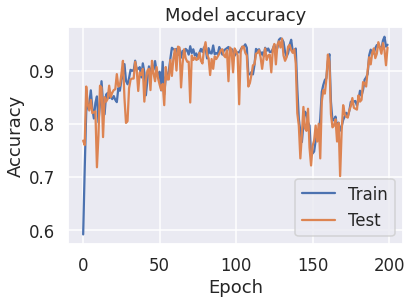

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')

plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='lower right')
plt.show()

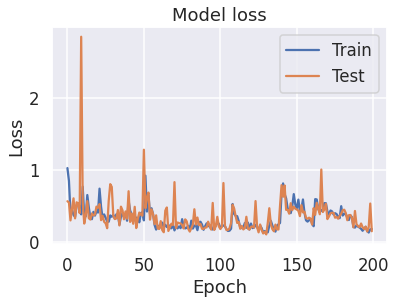

In [ ]:
plt.plot(history.history['loss']) 
plt.plot(history.history['val_loss']) 
plt.title('Model loss') 
plt.ylabel('Loss') 
plt.xlabel('Epoch') 
plt.legend(['Train', 'Test'], loc='upper right') 
plt.show()

              precision    recall  f1-score   support

           0       0.99      0.93      0.96       151
           1       0.88      0.98      0.93       146
           2       0.98      0.87      0.92       148
           3       0.94      0.99      0.97       155

    accuracy                           0.94       600
   macro avg       0.95      0.94      0.94       600
weighted avg       0.95      0.94      0.94       600



<function matplotlib.pyplot.show>

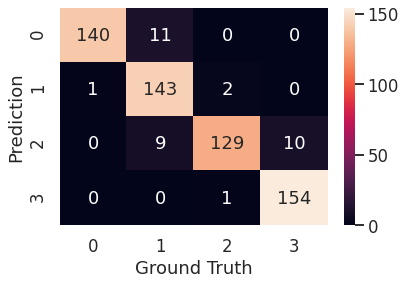

In [ ]:
y_pred = best_NN_model.predict(X_test)

#Converting predictions to label
pred = list()
for i in range(len(y_pred)):
    pred.append(np.argmax(y_pred[i]))
    
#Converting one hot encoded test label to label
test = list()
for i in range(len(y_test)):
    test.append(np.argmax(y_test[i]))
    
    
print(classification_report(test,pred))

cm = confusion_matrix(test, pred)

plot = sns.heatmap(cm, annot=True, fmt='d')
plt.xlabel("Ground Truth")
plt.ylabel("Prediction")
plt.show

####**Decision Tree**

In [ ]:
feature_cols = [x for x in data.columns if x not in ['price_range'] ]
X = data[feature_cols]
y = data['price_range']

#Splitting the data to training set and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42, stratify = y)

In [ ]:
# Train Decision Tree Classifier
dt = DecisionTreeClassifier(random_state=42)

dt = dt.fit(X_train, y_train)

#Prediction
y_train_pred = dt.predict(X_train)
y_test_pred = dt.predict(X_test)

Evaluating the performance metrices

In [ ]:
#training set
print(classification_report(y_train, y_train_pred))
#testing set
print(classification_report(y_test, y_test_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       350
           1       1.00      1.00      1.00       350
           2       1.00      1.00      1.00       350
           3       1.00      1.00      1.00       350

    accuracy                           1.00      1400
   macro avg       1.00      1.00      1.00      1400
weighted avg       1.00      1.00      1.00      1400

              precision    recall  f1-score   support

           0       0.90      0.89      0.89       150
           1       0.79      0.75      0.77       150
           2       0.74      0.74      0.74       150
           3       0.84      0.89      0.86       150

    accuracy                           0.82       600
   macro avg       0.82      0.82      0.82       600
weighted avg       0.82      0.82      0.82       600



In [ ]:
#Data after scaling
mms = MinMaxScaler()
X_train_scaled = mms.fit_transform(X_train)
X_test_scaled = mms.transform(X_test) 

#Fitting scaled data into Decision tree
dt_scaled = DecisionTreeClassifier(random_state=42)
dt_scaled = dt_scaled.fit(X_train_scaled, y_train)

#Prediction for scaled data
y_train_pred_scaled = dt_scaled.predict(X_train_scaled)
y_test_pred_scaled = dt_scaled.predict(X_test_scaled)

In [ ]:
#Performance metrices for scaled data

#training set
print(classification_report(y_train, y_train_pred_scaled))
#testing set
print(classification_report(y_test, y_test_pred_scaled))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       350
           1       1.00      1.00      1.00       350
           2       1.00      1.00      1.00       350
           3       1.00      1.00      1.00       350

    accuracy                           1.00      1400
   macro avg       1.00      1.00      1.00      1400
weighted avg       1.00      1.00      1.00      1400

              precision    recall  f1-score   support

           0       0.90      0.89      0.89       150
           1       0.79      0.75      0.77       150
           2       0.73      0.74      0.74       150
           3       0.84      0.88      0.86       150

    accuracy                           0.81       600
   macro avg       0.81      0.81      0.81       600
weighted avg       0.81      0.81      0.81       600



In [ ]:
#Data after scaling Using Standard Scaler

ss = StandardScaler()
X_train_ss= ss.fit_transform(X_train)
X_test_ss = ss.transform(X_test) 

#Fitting scaled data into Decision tree
dt_ss= DecisionTreeClassifier(random_state=42)
dt_ss = dt_scaled.fit(X_train_ss, y_train)

#Prediction for scaled data (Standard Scaler)
y_train_pred_ss = dt_ss.predict(X_train_ss)
y_test_pred_ss = dt_ss.predict(X_test_ss)

In [ ]:
#Performance metrices for scaled data (Standard Scaler)
from sklearn.metrics import classification_report
#training set
print(classification_report(y_train, y_train_pred_ss))
#testing set
print(classification_report(y_test, y_test_pred_ss))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       350
           1       1.00      1.00      1.00       350
           2       1.00      1.00      1.00       350
           3       1.00      1.00      1.00       350

    accuracy                           1.00      1400
   macro avg       1.00      1.00      1.00      1400
weighted avg       1.00      1.00      1.00      1400

              precision    recall  f1-score   support

           0       0.90      0.89      0.89       150
           1       0.79      0.75      0.77       150
           2       0.74      0.74      0.74       150
           3       0.84      0.89      0.86       150

    accuracy                           0.82       600
   macro avg       0.82      0.82      0.82       600
weighted avg       0.82      0.82      0.82       600



In [ ]:
#Using cross validation for non_scaled data

params = {'max_leaf_nodes': list(range(2, 100)), 'min_samples_split': [2, 3, 4]}
grid_search_cv = GridSearchCV(DecisionTreeClassifier(random_state=42), params, n_jobs=-1, verbose=1, cv=3)
grid_search_cv.fit(X_train, y_train)

Fitting 3 folds for each of 294 candidates, totalling 882 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done 360 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 882 out of 882 | elapsed:    7.9s finished


GridSearchCV(cv=3, error_score=nan,
             estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features=None,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              presort='deprecated',
                                              random_state=42,
                                              splitter='best'),
             iid='deprecated', n_jobs=-1,
             param_grid={'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
  

In [ ]:
#Find the best params
grid_search_cv.best_estimator_.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': 29,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': 42,
 'splitter': 'best'}

In [ ]:
#Using cv
y_test_pred_cv = grid_search_cv.predict(X_test)
print(classification_report(y_test, y_test_pred_cv))
#Higher accuracy than without cross validation

              precision    recall  f1-score   support

           0       0.94      0.91      0.92       150
           1       0.79      0.85      0.82       150
           2       0.78      0.71      0.74       150
           3       0.85      0.89      0.87       150

    accuracy                           0.84       600
   macro avg       0.84      0.84      0.84       600
weighted avg       0.84      0.84      0.84       600



Text(0.5, 55.5, 'Ground Truth')

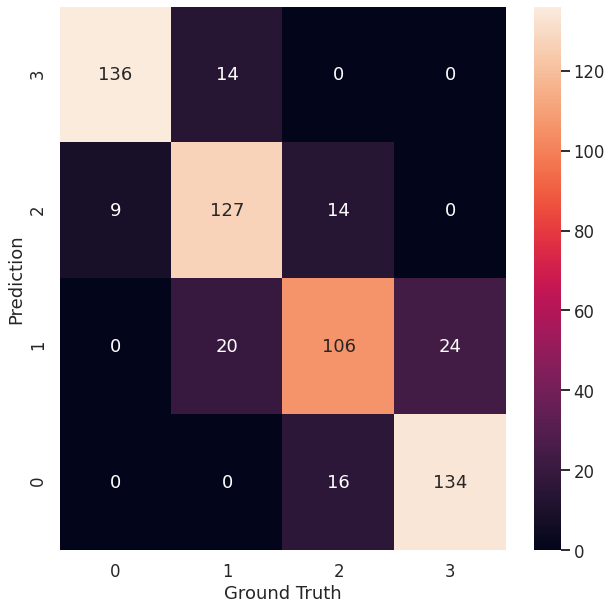

In [ ]:
#Confusion Matrix
#For training set
#cm_train = confusion_matrix(y_train, y_train_pred)
#For testing set
cm_test_cv = confusion_matrix(y_test, y_test_pred_cv)

#print(cm_train, cm_test)

#Plot the cpnfusion matrix (Using cv cause it give the most accurate result)

labels = sorted(y_test.unique()) #get the labels
cm = pd.DataFrame(cm_test_cv, index=labels, columns=labels) #in matrics form

fig = plt.figure(figsize=(10,10))
sns.set_context('talk')
ax = sns.heatmap(cm, annot=True, fmt='d', xticklabels=True, yticklabels=True)
ax.set_xticklabels(labels)
ax.set_yticklabels(labels[::-1]) #reverse the labels
ax.set_ylabel('Prediction')
ax.set_xlabel('Ground Truth')

####**K Means Clustering**

In [ ]:
#Import the data
train_data = pd.read_csv('train.csv')

#Get the features and labels
X_col = [x for x in train_data.columns if x not in ['price_range']]
X = train_data[X_col]
y = train_data['price_range']

#Splitting into training and testing set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [ ]:
#choose only floats data
float_col = [x for x in train_data.columns if x in ['clock_speed', 'm_dep']]

In [ ]:
#Perform feature scaling

sc = StandardScaler()
train_data[float_col] = sc.fit_transform(train_data[float_col])

In [ ]:
km = KMeans(n_clusters=4, random_state=42)
km = km.fit(train_data[float_col])
train_data['kmeans'] = km.predict(train_data[float_col])
(train_data[['price_range','kmeans']]
 .groupby(['price_range','kmeans'])
 .size()
 .to_frame()
 .rename(columns={0:'number'}))

number
price_range kmeans        
0           0          129
            1          137
            2          113
            3          121
1           0          130
            1          141
            2          127
            3          102
2           0          120
            1          145
            2          114
            3          121
3           0          123
            1          136
            2          126
            3          115

In [ ]:
# Find the best n-cluster
km_list = list()

for clust in range(2,30):
    km = KMeans(n_clusters=clust, random_state=42)
    km = km.fit(train_data[float_col])
    
    km_list.append(pd.Series({'clusters': clust, 
                              'inertia': km.inertia_,
                              'model': km}))

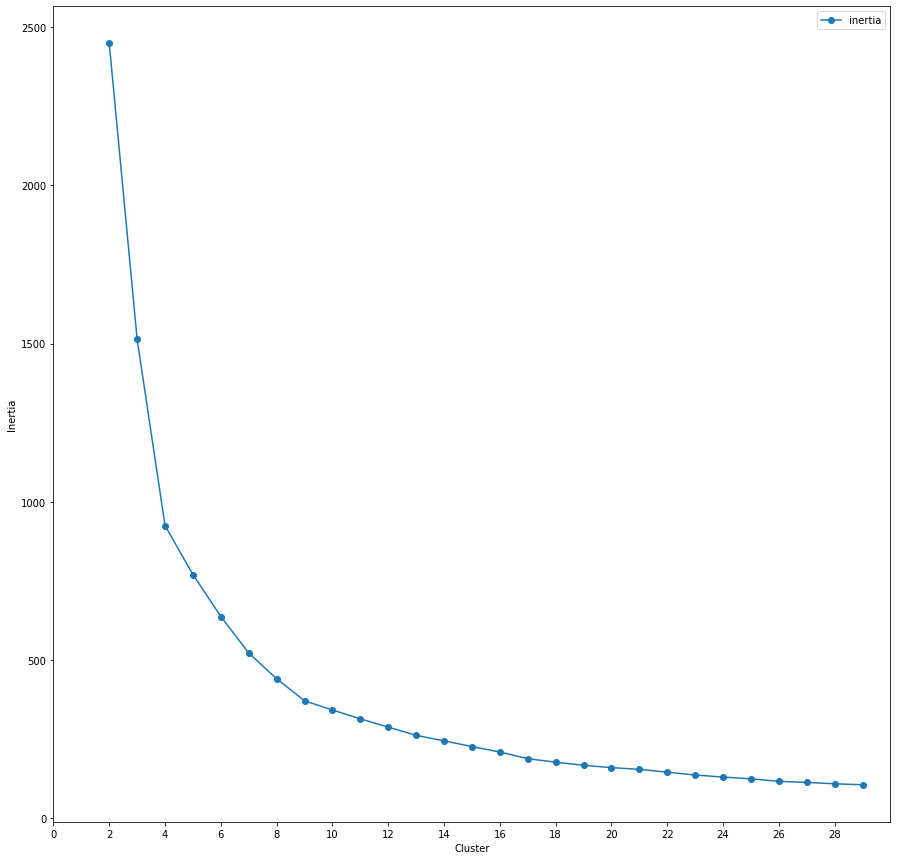

In [ ]:
#Graph Visualization
plot_data = (pd.concat(km_list, axis=1)
             .T
             [['clusters','inertia']]
             .set_index('clusters'))

ax = plot_data.plot(marker='o',ls='-',figsize=(15, 15))
ax.set_xticks(range(0,30,2))
ax.set_xlim(0,30)
ax.set(xlabel='Cluster', ylabel='Inertia');

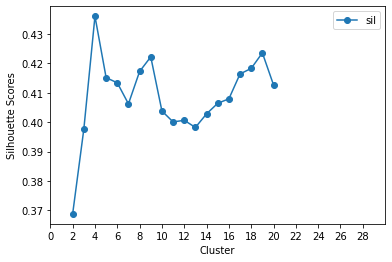

In [ ]:
#Show silhoutte score
km_list = list()

for clust in range(2,21):
    km = KMeans(n_clusters=clust, random_state=42)
    km = km.fit(train_data[float_col])
    y_pred = km.predict(train_data[float_col])
    
    km_list.append(pd.Series({'clusters': clust, 
                              'inertia': km.inertia_,
                              'model': km,
                             'sil': silhouette_score(train_data[float_col], y_pred)}))
plot_data = (pd.concat(km_list, axis=1)
             .T
             [['clusters','sil']]
             .set_index('clusters'))

ax = plot_data.plot(marker='o',ls='-')
ax.set_xticks(range(0,30,2))
ax.set_xlim(0,30)
ax.set(xlabel='Cluster', ylabel='Silhouette Scores');

In [ ]:
#Fit an agglomerative clustering

ag = AgglomerativeClustering(n_clusters=4, linkage='ward', compute_full_tree=True)
ag = ag.fit(train_data[float_col])
train_data['agglom'] = ag.fit_predict(train_data[float_col])

In [ ]:
(train_data[['price_range','agglom','kmeans']]
 .groupby(['price_range','agglom','kmeans'])
 .size()
 .to_frame()
 .rename(columns={0:'number'}))

number
price_range agglom kmeans        
0           0      0           27
                   1           15
                   3          121
            1      0           17
                   2           99
            2      1          122
                   2           14
            3      0           85
1           0      0           25
                   1            9
                   2            1
                   3          102
            1      0           27
                   2          110
            2      1          132
                   2           16
            3      0           78
2           0      0           21
                   1           16
                   3          121
            1      0           18
                   2          100
            2      1          129
                   2           14
            3      0           81
3           0      0           23
                   1           15
                   2            1
                   3          115
            1      0           22
                   2          114
            2      1          121
                   2           11
            3      0           78

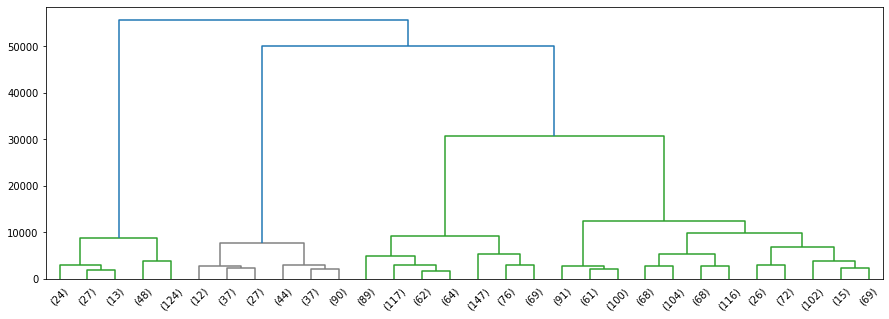

In [ ]:
Z = hierarchy.linkage(ag.children_, method='ward')

fig, ax = plt.subplots(figsize=(15,5))

# Some color customization
dark_palette = sns.color_palette()
red = colors.to_hex(dark_palette[2])
blue = colors.to_hex(dark_palette[0])

hierarchy.set_link_color_palette([red, 'gray'])

den = hierarchy.dendrogram(Z, orientation='top', 
                           p=30, truncate_mode='lastp',
                           show_leaf_counts=True, ax=ax,
                           above_threshold_color=blue)

In [ ]:
y = (train_data['price_range'] > 0).astype(int)
X_with_kmeans = train_data.drop(['agglom', 'battery_power', 'blue'
                                 , 'dual_sim', 'fc', 'four_g','int_memory','mobile_wt'
                                 ,'n_cores','pc','px_height','px_width','ram','sc_h'
                                 ,'sc_w','talk_time','three_g','touch_screen', 'wifi'], axis=1)
X_without_kmeans = X_with_kmeans.drop('kmeans', axis=1)
sss = StratifiedShuffleSplit(n_splits=10, random_state=6532)


def get_avg_roc_10splits(estimator, X, y):
    roc_auc_list = []
    for train_index, test_index in sss.split(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        estimator.fit(X_train, y_train)
        y_predicted = estimator.predict(X_test)
        y_scored = estimator.predict_proba(X_test)[:, 1]
        roc_auc_list.append(roc_auc_score(y_test, y_scored))
    return np.mean(roc_auc_list)

In [ ]:
estimator = RandomForestClassifier()
roc_with_kmeans = get_avg_roc_10splits(estimator, X_with_kmeans, y)
roc_without_kmeans = get_avg_roc_10splits(estimator, X_without_kmeans, y)
print("Without kmeans cluster as input to Random Forest, roc-auc is \"{0}\"".format(roc_without_kmeans))
print("Using kmeans cluster as input to Random Forest, roc-auc is \"{0}\"".format(roc_with_kmeans))

Without kmeans cluster as input to Random Forest, roc-auc is "1.0"
Using kmeans cluster as input to Random Forest, roc-auc is "1.0"


[0.5156200000000001, 0.5128466666666667, 0.5051666666666667, 0.4956866666666667, 0.4979133333333333, 0.49804666666666664, 0.5017266666666667, 0.49182, 0.5124866666666666, 0.5286466666666667, 0.5241, 0.4994866666666667, 0.5198866666666667, 0.5249133333333333, 0.5046466666666667, 0.51466, 0.48954000000000003, 0.5181, 0.5326733333333333, 0.5154333333333334]


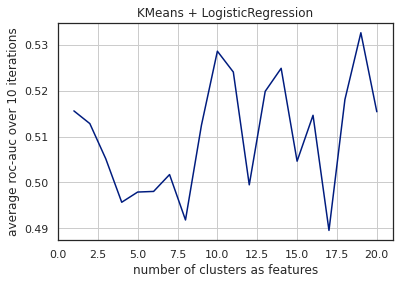

In [ ]:
X_basis = train_data[float_col]
sss = StratifiedShuffleSplit(n_splits=10, random_state=6532)


def create_kmeans_columns(n):
    km = KMeans(n_clusters=n)
    km.fit(X_basis)
    km_col = pd.Series(km.predict(X_basis))
    km_cols = pd.get_dummies(km_col, prefix='kmeans_cluster')
    return pd.concat([X_basis, km_cols], axis=1)


estimator = LogisticRegression()
ns = range(1, 21)
roc_auc_list = [get_avg_roc_10splits(estimator, create_kmeans_columns(n), y)
                for n in ns]
print(roc_auc_list)


# seaborn styles
sns.set_context('notebook')
sns.set_style('white')
sns.set_palette('dark')

ax = plt.axes()
ax.plot(ns, roc_auc_list)
ax.set(
    #xticklabels= ns,
    xlim=(0, 21),
    xlabel='number of clusters as features',
    ylabel='average roc-auc over 10 iterations',
    title='KMeans + LogisticRegression'
)
ax.grid(True)

In [ ]:
#For DBSCAN
X_basis_1 = train_data[float_col]
sss = StratifiedShuffleSplit(n_splits=10, random_state=6532)

def create_DBSCAN_columns(n):
    db = DBSCAN()
    db.fit(X_basis_1)
    db_col = pd.Series(db.fit_predict(X_basis_1))
    db_cols = pd.get_dummies(db_col, prefix='db_cluster')
    return pd.concat([X_basis_1, db_cols], axis=1)

estimator_1 = LogisticRegression()
ns_1 = range(1, 21)
roc_auc_list_1 = [get_avg_roc_10splits(estimator_1, create_DBSCAN_columns(n), y)
                for n in ns_1]

print(roc_auc_list_1)

[0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001, 0.5156200000000001]


In [ ]:
#Birch
X_basis_2 = train_data[float_col]
sss = StratifiedShuffleSplit(n_splits=10, random_state=6532)

def create_Birch_columns(n):
    bi = Birch(n_clusters=n)
    bi.fit(X_basis_2)
    bi_col = pd.Series(bi.predict(X_basis_2))
    bi_cols = pd.get_dummies(bi_col, prefix='bi_cluster')
    return pd.concat([X_basis_2, bi_cols], axis=1)

estimator_2 = LogisticRegression()
ns_2 = range(1, 21)
roc_auc_list_2 = [get_avg_roc_10splits(estimator_2, create_Birch_columns(n), y)
                for n in ns_2]

print(roc_auc_list_2)

[0.5156200000000001, 0.5180199999999999, 0.5189933333333334, 0.51178, 0.5122466666666667, 0.50806, 0.5025933333333333, 0.49742, 0.5142466666666666, 0.5116866666666666, 0.5066066666666666, 0.5239533333333333, 0.5239533333333333, 0.5239533333333333, 0.5239533333333333, 0.5239533333333333, 0.5239533333333333, 0.5239533333333333, 0.5239533333333333, 0.5239533333333333]


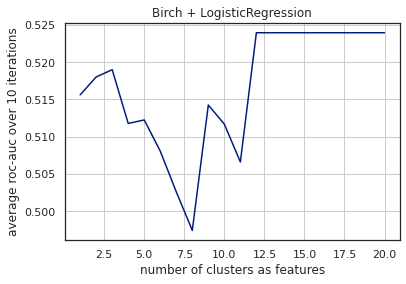

In [ ]:
ax_2 = plt.axes()
ax_2.plot(ns_2, roc_auc_list_2)
ax_2.set(
    #xticklabels= ns_1,
    xlabel='number of clusters as features',
    ylabel='average roc-auc over 10 iterations',
    title='Birch + LogisticRegression'
)
ax_2.grid(True)

In [ ]:
#Set n_clusters = 4
km = KMeans(n_clusters=4, random_state=42)
km = km.fit(X_train)
train_pred = km.predict(X_test)

#Find the accuracy
def accuracy(real, predict):
        return sum(real == predict)/float(real.shape[0])
accuracy(y_test, train_pred)

0.4325

In [ ]:
#Low accuracy, use min-max scaling

msc = MinMaxScaler()
X_train_msc = msc.fit_transform(X_train)
X_test_msc = msc.transform(X_test)

#Train model again
km = KMeans(n_clusters=4, random_state=42)
km = km.fit(X_train_msc)
train_pred_msc = km.predict(X_test_msc)

#Find the accuracy
def accuracy(real, predict):
        return sum(real == predict)/float(real.shape[0])
accuracy(y_test, train_pred_msc)

0.2275

In [ ]:
#Change to Standard Scaler
ss = StandardScaler()
X_train_ss = ss.fit_transform(X_train)
X_test_ss = ss.transform(X_test)
#Train model again
km = KMeans(n_clusters=4, random_state=42)
km = km.fit(X_train_ss)
train_pred_ss = km.predict(X_test_ss)

#Find the accuracy
def accuracy(real, predict):
        return sum(real == predict)/float(real.shape[0])
accuracy(y_test, train_pred_ss)

0.2175

These results above do not show a high accuracy we can state that K-Means is not suitable to be used for the prediction of mobile price ranges. It is because the dataset contains many discrete value but K-Means is commonly applied for continuous data type, while the data we possess are discrete data types.

In [ ]:
#Using DBScan
#Train model
db = DBSCAN(eps=3, min_samples=2)
db = db.fit(X_train_ss)
train_pred_db = db.fit_predict(X_test_ss)

#Find the accuracy
def accuracy(real, predict):
        return sum(real == predict)/float(real.shape[0])
accuracy(y_test, train_pred_db)

0.0075

In [ ]:
#Using Birch
#Train model
bi = Birch(n_clusters=4)
bi = bi.fit(X_train)
train_pred_bi = bi.fit(X_test)

#Find the accuracy
def accuracy(real, predict):
        return sum(real == predict)/float(real.shape[0])
accuracy(y_test, train_pred_bi)

0.0

##**Task Allocation and Project Plan**

Based on the webpage provided by the lecturer, Dr. Chaw Jun Kit, we prepared the following project plan.

link: https://towardsdatascience.com/machine-learning-project-planning-71bdb3a44349#_=_

**What are the predictor variables?**<br>
The predictor variables are all of the features in the dataset except the price range.<br>

**battery_power**: Total energy a battery can store in one time measured in mAh

**blue**: Has bluetooth or not

**clock_speed**: speed at which microprocessor executes instructions

**dual_sim**: Has dual sim support or not

**fc**: Front Camera mega pixels

**four_g**: Has 4G or not

**int_memory**: Internal Memory in Gigabytes

**m_dep**: Mobile Depth in cm

**mobile_wt**: Weight of mobile phone

**n_cores**: Number of cores of processor

**pc**: Primary Camera mega pixels

**px_height**: Pixel Resolution Height

**px_width**: Pixel Resolution Width

**ram**: Random Access Memory in Mega Bytes

**sc_h**: Screen Height of mobile in cm

**sc_w**: Screen Width of mobile in cm

**talk_time**: longest time that a single battery charge will last when you are

**three_g**: Has 3G or not

**touch_screen**: Has touch screen or not

**wifi**: Has wifi or not

**price_range**: This is the target variable with value of 0(low cost), 1(medium cost), 2(high cost) and 3(very high cost).

**What is the target variable? Is my target variable discrete or continuous?**<br>
The target variable is the price range of mobile phones. The target variable in our dataset is discrete: 1, 2, 3, and 4.
- 0 = Cheap 
- 1 = Standard 
- 2 = Expensive 
- 3 = Very Expensive

**Should I use clustering, classification, regression analysis, or time series analysis?**<br>
In this project, we are using classification analysis since the target variable is discrete.

**How do I handle missing values in my dataset?**<br>
There are no missing values in our dataset.

**Should I use normalization or standardization when bringing variables to the same scale?**<br>
We are using standardization, since it is easier to learn the weights. It will also maintain the information that is useful about outliers and algorithms to be less sensitive to them.

**Should I reduce the dimensionality of my feature space?**<br>
No, because there are no high correlations between any two features.

**How do I tune hyperparameters in my model?**<br>
In order to obtain a model with highest accuracy,  we will train our model with different hyperparameters and compare the accuracy. For some models, GridSearchCV from scikit-learn can handle this work well. 

**How do I evaluate my model to detect biases in the dataset?**<br>
We use accuracy, confusion matrix, auc score and other metrics to do model evaluation so that we can detect the biases in the dataset.

**Should I use ensemble methods where I train using different models then perform an ensemble average, e.g. using classifiers such as SVM, KNN, Logistic Regression, then average over 3 models?**<br>
No need, as we are lacking in resources like time and knowledge.

**How do I select the final model?**<br>
We select the model with the best performance metrics score. This will help us to get a more generalised model and prevent us from getting an overfitting model.

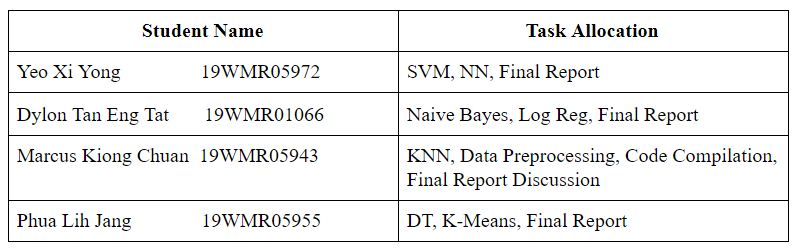